#Data Loader

In [28]:
from __future__ import annotations

import io, time
from dataclasses import dataclass
from typing import Optional, Tuple

import numpy as np
import pandas as pd
import requests, certifi


@dataclass
class DataConfig:
    url: str = (
        "https://raw.githubusercontent.com/bredeespelid/"
        "Data_MasterOppgave/refs/heads/main/Variables/All_Variables/variables_daily.csv"
    )
    retries: int = 3
    timeout: int = 60


DATA_CFG = DataConfig()


def download_csv_text(url: str, retries: int, timeout: int) -> str:
    last_err = None
    for k in range(1, retries + 1):
        try:
            r = requests.get(url, timeout=timeout, verify=certifi.where())
            r.raise_for_status()
            return r.text
        except Exception as e:
            last_err = e
            if k < retries:
                wait = 1.5 * k
                print(f"[warning] Download failed (try {k}/{retries}): {e}. Retrying in {wait:.1f}s ...")
                time.sleep(wait)
    raise RuntimeError(f"Download failed: {last_err}")


def load_fx_series_daily_and_business(
    url: str,
    series: str = "EUR_NOK",
    retries: int = 3,
    timeout: int = 60,
) -> Tuple[pd.Series, pd.Series]:
    """
    Load (Date, series) from CSV.
    Returns:
      S_b: business-day (B) ffilled
      S_d: calendar-day (D) ffilled
    """
    text = download_csv_text(url, retries, timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date", series}
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns in CSV: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[["Date", series]]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE", series])
        .sort_values("DATE")
        .set_index("DATE")
    )

    df[series] = pd.to_numeric(df[series], errors="coerce")
    df = df.dropna(subset=[series])
    if df.empty:
        raise ValueError("Dataset is empty after cleaning.")

    S_b = df[series].asfreq("B").ffill().astype(float)
    S_b.name = series

    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    S_d = df[series].reindex(full_idx).ffill().astype(float)
    S_d.index.name = "DATE"
    S_d.name = series

    return S_b, S_d


def last_trading_day(S_b: pd.Series, start: pd.Timestamp, end: pd.Timestamp) -> Optional[pd.Timestamp]:
    sl = S_b.loc[start:end]
    return sl.index[-1] if not sl.empty else None


# Eval

In [29]:
# =========================
# eval_common_monthly (M)
# =========================
from __future__ import annotations
import math
from typing import Tuple, Optional, Dict

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

EVAL_MONTHLY = {}

def _normal_cdf(z: float) -> float:
    return 0.5 * (1.0 + math.erf(z / math.sqrt(2.0)))

def dm_test(y_true: pd.Series, y_model: pd.Series, y_rw: pd.Series, h: int = 1, loss: str = "mse") -> Tuple[float, float]:
    df = pd.concat({"y": y_true, "m": y_model, "rw": y_rw}, axis=1).dropna()
    if df.empty or len(df) < 5:
        return float("nan"), float("nan")

    e_m = df["y"] - df["m"]
    e_r = df["y"] - df["rw"]
    d = (np.abs(e_m) - np.abs(e_r)) if loss.lower() == "mae" else ((e_m**2) - (e_r**2))

    N = int(len(d))
    d_mean = float(d.mean())
    gamma0 = float(np.var(d, ddof=1)) if N > 1 else 0.0
    var_bar = gamma0 / N

    # HAC Newey–West Bartlett up to h-1
    if h > 1 and N > 2:
        for k in range(1, min(h - 1, N - 1) + 1):
            w_k = 1.0 - k / h
            cov_k = float(np.cov(d[k:], d[:-k], ddof=1)[0, 1])
            var_bar += 2.0 * w_k * cov_k / N

    if var_bar <= 0 or not np.isfinite(var_bar):
        return float("nan"), float("nan")

    dm_stat = d_mean / math.sqrt(var_bar)
    p_val = 2.0 * (1.0 - _normal_cdf(abs(dm_stat)))
    return float(dm_stat), float(p_val)

def evaluate_period_df_monthly(
    period_df: pd.DataFrame,
    *,
    loss: str = "mse",
    h: int = 1,
    label: str = "Model",
    print_output: bool = True,
) -> Tuple[pd.DataFrame, Dict]:
    """
    Forventer period_df indeksert på PeriodIndex(freq='M') og kolonner:
      - y_true, y_pred
      - cut_level  (RW benchmark ved cut; driftless)
    """
    df = period_df.copy()
    required = {"y_true", "y_pred", "cut_level"}
    missing = required - set(df.columns)
    if missing:
        raise ValueError(f"Mangler kolonner: {missing}. Legg til cut_level=float(S_b.loc[cut]) i walk-forward.")

    core = df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    core["err"] = core["y_true"] - core["y_pred"]

    n_obs = int(len(core))
    rmse = float(np.sqrt(np.mean(np.square(core["err"])))) if n_obs else float("nan")
    mae  = float(np.mean(np.abs(core["err"]))) if n_obs else float("nan")

    # Directional accuracy på periodemidler
    core["y_prev"] = core["y_true"].shift(1)
    mask = core["y_prev"].notna()
    total = int(mask.sum())
    hits = 0
    dir_acc = float("nan")
    if total:
        dir_true = np.sign(core.loc[mask, "y_true"] - core.loc[mask, "y_prev"])
        dir_pred = np.sign(core.loc[mask, "y_pred"] - core.loc[mask, "y_prev"])
        hits = int((dir_true.values == dir_pred.values).sum())
        dir_acc = float(hits / total)

    # RW (cut-level)
    core["rw_pred"] = core["cut_level"].astype(float)

    dm_stat, p_val = dm_test(core["y_true"], core["y_pred"], core["rw_pred"], h=h, loss=loss)

    # Konvensjon: DM < 0 => bedre enn RW (lavere gj.snittlig loss)
    better_than_rw = bool(np.isfinite(dm_stat) and dm_stat < 0)
    sig = ""
    if better_than_rw and np.isfinite(p_val):
        if p_val < 0.01: sig = "***"
        elif p_val < 0.05: sig = "**"
        elif p_val < 0.10: sig = "*"

    res = dict(
        label=label,
        observations=n_obs,
        rmse=rmse,
        mae=mae,
        dir_hits=int(hits),
        dir_total=int(total),
        dir_acc=dir_acc,
        dm_stat=float(dm_stat) if np.isfinite(dm_stat) else float("nan"),
        dm_pvalue=float(p_val) if np.isfinite(p_val) else float("nan"),
        better_than_rw=better_than_rw,
        sig=sig,
    )

    if print_output:
        print(f"\n=== {label} (monthly mean) ===")
        print(f"Observations: {n_obs}")
        print(f"RMSE (level): {rmse:.6f}")
        print(f"MAE  (level): {mae:.6f}")
        if total:
            print(f"Directional accuracy: {hits}/{total} ({dir_acc*100:.1f}%)")
        print("\n=== Diebold–Mariano vs Random Walk (cut-level RW) ===")
        print(f"Loss: {loss.upper()} | horizon h={h}")
        print(f"DM-statistic: {dm_stat:.4f}" if np.isfinite(dm_stat) else "DM-statistic: nan")
        print(f"p-value     : {p_val:.4f}" if np.isfinite(p_val) else "p-value     : nan")
        if sig:
            print(f"Significance: {sig} (model better than RW)")

    return core, res

def plot_period_simple_monthly(
    period_df: pd.DataFrame,
    *,
    title: str,
    png_path: str,
    pdf_path: Optional[str] = None,
    y_label: str = "Level",
    show: bool = True,
) -> None:
    df = period_df.dropna(subset=["y_true", "y_pred"]).copy()
    if df.empty:
        print("Nothing to plot.")
        return

    x = df.index.to_timestamp() if isinstance(df.index, pd.PeriodIndex) else df.index

    plt.figure(figsize=(10, 6))
    plt.plot(x, df["y_true"], color="black", label="Actual (monthly mean)")
    plt.plot(x, df["y_pred"], color="tab:blue", linestyle="--", label="Forecast")
    plt.title(title)
    plt.xlabel("Month")
    plt.ylabel(y_label)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    plt.savefig(png_path, dpi=300, bbox_inches="tight")
    if pdf_path:
        plt.savefig(pdf_path, bbox_inches="tight")
    if show:
        plt.show()
    else:
        plt.close()

    print(f"Saved: {png_path}")
    if pdf_path:
        print(f"Saved: {pdf_path}")

EVAL_MONTHLY["evaluate_period_df"] = evaluate_period_df_monthly
EVAL_MONTHLY["plot_period_simple"] = plot_period_simple_monthly
print("Loaded eval_common_monthly: EVAL_MONTHLY['evaluate_period_df'], EVAL_MONTHLY['plot_period_simple']")


Loaded eval_common_monthly: EVAL_MONTHLY['evaluate_period_df'], EVAL_MONTHLY['plot_period_simple']


In [30]:
# =========================
# eval_common_quarterly (Q-DEC)
# =========================
from __future__ import annotations
import math
from typing import Tuple, Optional, Dict

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

EVAL_QUARTERLY = {}

def _normal_cdf(z: float) -> float:
    return 0.5 * (1.0 + math.erf(z / math.sqrt(2.0)))

def dm_test(y_true: pd.Series, y_model: pd.Series, y_rw: pd.Series, h: int = 1, loss: str = "mse") -> Tuple[float, float]:
    df = pd.concat({"y": y_true, "m": y_model, "rw": y_rw}, axis=1).dropna()
    if df.empty or len(df) < 5:
        return float("nan"), float("nan")

    e_m = df["y"] - df["m"]
    e_r = df["y"] - df["rw"]
    d = (np.abs(e_m) - np.abs(e_r)) if loss.lower() == "mae" else ((e_m**2) - (e_r**2))

    N = int(len(d))
    d_mean = float(d.mean())
    gamma0 = float(np.var(d, ddof=1)) if N > 1 else 0.0
    var_bar = gamma0 / N

    # HAC Newey–West Bartlett up to h-1
    if h > 1 and N > 2:
        for k in range(1, min(h - 1, N - 1) + 1):
            w_k = 1.0 - k / h
            cov_k = float(np.cov(d[k:], d[:-k], ddof=1)[0, 1])
            var_bar += 2.0 * w_k * cov_k / N

    if var_bar <= 0 or not np.isfinite(var_bar):
        return float("nan"), float("nan")

    dm_stat = d_mean / math.sqrt(var_bar)
    p_val = 2.0 * (1.0 - _normal_cdf(abs(dm_stat)))
    return float(dm_stat), float(p_val)

def evaluate_period_df_quarterly(
    period_df: pd.DataFrame,
    *,
    loss: str = "mse",
    h: int = 1,
    label: str = "Model",
    print_output: bool = True,
) -> Tuple[pd.DataFrame, Dict]:
    """
    Forventer period_df indeksert på PeriodIndex(freq='Q-DEC') og kolonner:
      - y_true, y_pred
      - cut_level  (RW benchmark ved cut; driftless)
    """
    df = period_df.copy()
    required = {"y_true", "y_pred", "cut_level"}
    missing = required - set(df.columns)
    if missing:
        raise ValueError(f"Mangler kolonner: {missing}. Legg til cut_level=float(S_b.loc[cut]) i walk-forward.")

    core = df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    core["err"] = core["y_true"] - core["y_pred"]

    n_obs = int(len(core))
    rmse = float(np.sqrt(np.mean(np.square(core["err"])))) if n_obs else float("nan")
    mae  = float(np.mean(np.abs(core["err"]))) if n_obs else float("nan")

    # Directional accuracy på periodemidler
    core["y_prev"] = core["y_true"].shift(1)
    mask = core["y_prev"].notna()
    total = int(mask.sum())
    hits = 0
    dir_acc = float("nan")
    if total:
        dir_true = np.sign(core.loc[mask, "y_true"] - core.loc[mask, "y_prev"])
        dir_pred = np.sign(core.loc[mask, "y_pred"] - core.loc[mask, "y_prev"])
        hits = int((dir_true.values == dir_pred.values).sum())
        dir_acc = float(hits / total)

    # RW (cut-level)
    core["rw_pred"] = core["cut_level"].astype(float)

    dm_stat, p_val = dm_test(core["y_true"], core["y_pred"], core["rw_pred"], h=h, loss=loss)

    # Konvensjon: DM < 0 => bedre enn RW (lavere gj.snittlig loss)
    better_than_rw = bool(np.isfinite(dm_stat) and dm_stat < 0)
    sig = ""
    if better_than_rw and np.isfinite(p_val):
        if p_val < 0.01: sig = "***"
        elif p_val < 0.05: sig = "**"
        elif p_val < 0.10: sig = "*"

    res = dict(
        label=label,
        observations=n_obs,
        rmse=rmse,
        mae=mae,
        dir_hits=int(hits),
        dir_total=int(total),
        dir_acc=dir_acc,
        dm_stat=float(dm_stat) if np.isfinite(dm_stat) else float("nan"),
        dm_pvalue=float(p_val) if np.isfinite(p_val) else float("nan"),
        better_than_rw=better_than_rw,
        sig=sig,
    )

    if print_output:
        print(f"\n=== {label} (quarterly mean) ===")
        print(f"Observations: {n_obs}")
        print(f"RMSE (level): {rmse:.6f}")
        print(f"MAE  (level): {mae:.6f}")
        if total:
            print(f"Directional accuracy: {hits}/{total} ({dir_acc*100:.1f}%)")
        print("\n=== Diebold–Mariano vs Random Walk (cut-level RW) ===")
        print(f"Loss: {loss.upper()} | horizon h={h}")
        print(f"DM-statistic: {dm_stat:.4f}" if np.isfinite(dm_stat) else "DM-statistic: nan")
        print(f"p-value     : {p_val:.4f}" if np.isfinite(p_val) else "p-value     : nan")
        if sig:
            print(f"Significance: {sig} (model better than RW)")

    return core, res

def plot_period_simple_quarterly(
    period_df: pd.DataFrame,
    *,
    title: str,
    png_path: str,
    pdf_path: Optional[str] = None,
    y_label: str = "Level",
    show: bool = True,
) -> None:
    df = period_df.dropna(subset=["y_true", "y_pred"]).copy()
    if df.empty:
        print("Nothing to plot.")
        return

    x = df.index.to_timestamp() if isinstance(df.index, pd.PeriodIndex) else df.index

    plt.figure(figsize=(10, 6))
    plt.plot(x, df["y_true"], color="black", label="Actual (quarterly mean)")
    plt.plot(x, df["y_pred"], color="tab:blue", linestyle="--", label="Forecast")
    plt.title(title)
    plt.xlabel("Quarter")
    plt.ylabel(y_label)
    plt.legend()
    plt.grid(True, alpha=0.3)
    plt.tight_layout()

    plt.savefig(png_path, dpi=300, bbox_inches="tight")
    if pdf_path:
        plt.savefig(pdf_path, bbox_inches="tight")
    if show:
        plt.show()
    else:
        plt.close()

    print(f"Saved: {png_path}")
    if pdf_path:
        print(f"Saved: {pdf_path}")

EVAL_QUARTERLY["evaluate_period_df"] = evaluate_period_df_quarterly
EVAL_QUARTERLY["plot_period_simple"] = plot_period_simple_quarterly
print("Loaded eval_common_quarterly: EVAL_QUARTERLY['evaluate_period_df'], EVAL_QUARTERLY['plot_period_simple']")


Loaded eval_common_quarterly: EVAL_QUARTERLY['evaluate_period_df'], EVAL_QUARTERLY['plot_period_simple']


# CUDA

In [31]:
!nvidia-smi


Thu Dec 18 19:18:23 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  NVIDIA A100-SXM4-40GB          Off |   00000000:00:04.0 Off |                    0 |
| N/A   31C    P0             49W /  400W |     539MiB /  40960MiB |      0%      Default |
|                                         |                        |             Disabled |
+-----------------------------------------+-----

In [32]:
!pip -q install -U xgboost
import xgboost
print(xgboost.__version__)


3.1.2


In [33]:
!pip -q install -U xgboost

from xgboost import XGBRegressor
import xgboost as xgb
print("xgboost version:", xgb.__version__)


xgboost version: 3.1.2


In [34]:
model = XGBRegressor(
    objective="reg:squarederror",
    eval_metric="rmse",
    tree_method="hist",
    device="cuda",
    n_estimators=4000,
    learning_rate=0.05,
    max_depth=4,
    subsample=0.8,
    colsample_bytree=0.8,
    n_jobs=1,
)


# Cross Validation Finder

In [4]:
# =========================
# 0) Imports + XGBoost (GPU)
# =========================
!pip -q install -U xgboost

import math, random
from dataclasses import dataclass
from typing import Dict, Tuple, List, Optional

import numpy as np
import pandas as pd
from joblib import Parallel, delayed
from xgboost import XGBRegressor

def _has_cuda() -> bool:
    try:
        import subprocess, shlex
        out = subprocess.check_output(shlex.split("nvidia-smi -L"), stderr=subprocess.STDOUT).decode()
        return ("GPU" in out) or ("NVIDIA" in out)
    except Exception:
        return False

DEVICE = "cuda" if _has_cuda() else "cpu"
print("XGBoost device:", DEVICE)


XGBoost device: cuda


In [5]:
import io
import pandas as pd
import requests, certifi

NB_PANEL_URL = (
    "https://raw.githubusercontent.com/bredeespelid/"
    "Data_MasterOppgave/refs/heads/main/FineTuneData/NB1980-1999.csv"
)

# Last data
r = requests.get(NB_PANEL_URL, timeout=60, verify=certifi.where())
r.raise_for_status()

df = pd.read_csv(
    io.StringIO(r.text),
    sep=";",
    decimal=".",
    encoding="utf-8-sig"
)

# Konverter dato
df["ds"] = pd.to_datetime(df["ds"], dayfirst=True, errors="coerce")
df = df.sort_values("ds").reset_index(drop=True)

# info()
print("=== df.info() ===")
df.info()

# head
print("\n=== df.head() ===")
display(df.head())

# tail
print("\n=== df.tail() ===")
display(df.tail())


=== df.info() ===
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4973 entries, 0 to 4972
Data columns (total 12 columns):
 #   Column  Non-Null Count  Dtype         
---  ------  --------------  -----         
 0   ds      4973 non-null   datetime64[ns]
 1   AUD     4808 non-null   float64       
 2   CAD     4808 non-null   float64       
 3   CHF     4808 non-null   float64       
 4   DKK     4808 non-null   float64       
 5   GBP     4808 non-null   float64       
 6   ISK     4789 non-null   float64       
 7   JPY     4808 non-null   float64       
 8   NZD     4930 non-null   float64       
 9   SEK     4807 non-null   float64       
 10  USD     4808 non-null   float64       
 11  XDR     4633 non-null   float64       
dtypes: datetime64[ns](1), float64(11)
memory usage: 466.3 KB

=== df.head() ===


,ds,AUD,CAD,CHF,DKK,GBP,ISK,JPY,NZD,SEK,USD,XDR
0,1980-12-10,6.1025,4.3585,288.85,85.30,12.210,1.86,2.494,4.9827,117.60,5.2225,6.58390
1,1980-12-11,6.1137,4.3800,287.50,85.10,12.280,1.86,2.502,4.9949,117.65,5.2535,6.57996
2,1980-12-12,6.1152,4.3675,287.45,85.05,12.160,1.86,2.503,4.9582,117.30,5.2530,6.58464
3,1980-12-15,6.0413,4.3115,289.85,86.00,12.105,1.85,2.497,4.9152,117.55,5.1810,6.56821
4,1980-12-16,6.0551,4.3010,285.75,84.55,12.080,1.85,2.479,4.9477,116.70,5.1995,6.53120



=== df.tail() ===


,ds,AUD,CAD,CHF,DKK,GBP,ISK,JPY,NZD,SEK,USD,XDR
4968,1999-12-27,5.1476,5.4526,505.23,108.96,12.936,11.11,7.8140,4.1276,94.60,7.9998,11.0006
4969,1999-12-28,5.1624,5.5103,503.71,108.70,12.943,11.14,7.8425,4.1322,94.32,8.0167,11.0017
4970,1999-12-29,5.1964,5.5232,502.58,108.44,12.963,11.07,7.8344,4.1773,94.24,8.0133,11.0053
4971,1999-12-30,5.2370,5.5288,503.18,108.51,12.991,11.09,7.8619,4.1724,94.32,8.0395,11.0218
4972,1999-12-31,5.2370,5.5288,503.18,108.51,12.991,11.09,7.8619,4.1724,94.32,8.0395,11.0053


In [6]:
# =========================
# 0) Imports + XGBoost (GPU)
# =========================
!pip -q install -U xgboost

import math, random
from dataclasses import dataclass
from typing import Dict, Tuple, List, Optional

import numpy as np
import pandas as pd
from joblib import Parallel, delayed
from xgboost import XGBRegressor

def _has_cuda() -> bool:
    try:
        import subprocess, shlex
        out = subprocess.check_output(shlex.split("nvidia-smi -L"), stderr=subprocess.STDOUT).decode()
        return ("GPU" in out) or ("NVIDIA" in out)
    except Exception:
        return False

DEVICE = "cuda" if _has_cuda() else "cpu"
print("XGBoost device:", DEVICE)

try:
    import cupy as cp
    _CUPY_OK = True
except Exception:
    cp = None
    _CUPY_OK = False

USE_GPU_ARRAYS = (DEVICE == "cuda") and _CUPY_OK
print("CuPy available:", _CUPY_OK, "| Use GPU arrays:", USE_GPU_ARRAYS)

def xgb_device_kwargs() -> Dict:
    return {"tree_method": "hist", "device": DEVICE}

def to_device_array(x):
    if USE_GPU_ARRAYS:
        return cp.asarray(x)
    return x

def predict_1d(model: XGBRegressor, x_row_2d: np.ndarray) -> float:
    if USE_GPU_ARRAYS:
        x_dev = to_device_array(x_row_2d)
        return float(cp.asnumpy(model.inplace_predict(x_dev))[0])
    return float(model.predict(x_row_2d)[0])

def fit_with_es(
    model: XGBRegressor,
    Xtr, ytr,
    Xva, yva,
    early_stopping_rounds: int
) -> XGBRegressor:
    fit_sig = None
    try:
        import inspect
        fit_sig = inspect.signature(model.fit)
    except Exception:
        fit_sig = None

    kwargs = {"eval_set": [(Xva, yva)], "verbose": False}

    if fit_sig is not None and "early_stopping_rounds" in fit_sig.parameters:
        kwargs["early_stopping_rounds"] = int(early_stopping_rounds)
        model.fit(Xtr, ytr, **kwargs)
        return model

    try:
        import xgboost
        if fit_sig is not None and "callbacks" in fit_sig.parameters:
            kwargs["callbacks"] = [xgboost.callback.EarlyStopping(rounds=int(early_stopping_rounds), save_best=True)]
            model.fit(Xtr, ytr, **kwargs)
            return model
    except Exception:
        pass

    model.fit(Xtr, ytr, **kwargs)
    return model


XGBoost device: cuda
CuPy available: True | Use GPU arrays: True


In [7]:
from __future__ import annotations

import io
import time
import random
import math
import inspect
from dataclasses import dataclass
from typing import Optional, Tuple, Dict

import numpy as np
import pandas as pd
import requests, certifi

from xgboost import XGBRegressor
from sklearn.metrics import mean_absolute_error

from tqdm.auto import tqdm


FINETUNE_FX_COLS = [
    "AUD", "CAD", "CHF", "DKK", "GBP",
    "ISK", "JPY", "NZD", "SEK", "USD", "XDR",
]

NB_PANEL_URL = (
    "https://raw.githubusercontent.com/bredeespelid/"
    "Data_MasterOppgave/refs/heads/main/FineTuneData/NB1980-1999.csv"
)


@dataclass
class Cfg:
    m_freq: str = "M"
    max_lags: int = 10
    max_horizon: int = 40
    min_hist_days: int = 40

    random_state: int = 42
    verbose: bool = True

    inner_start_period: str = "1985-01"
    inner_end_period: str = "1995-12"

    es_val_window: int = 60
    es_rounds: int = 50
    n_estimators_cap: int = 80

    n_trials: int = 15

    log_first_n_wf_errors: int = 3
    log_trial_summary: bool = True
    log_series_summary: bool = False

    topk_print: int = 10


CFG = Cfg()

_GPU_FALLBACK_LOGGED = False
_ES_MODE_LOGGED = False


def _print(msg: str) -> None:
    print(msg, flush=True)


def _has_cuda() -> bool:
    try:
        import subprocess, shlex
        out = subprocess.check_output(shlex.split("nvidia-smi -L"), stderr=subprocess.STDOUT).decode()
        return ("GPU" in out) or ("NVIDIA" in out)
    except Exception:
        return False


DEVICE = "cuda" if _has_cuda() else "cpu"

try:
    import cupy as cp
    _CUPY_OK = True
except Exception:
    cp = None
    _CUPY_OK = False

USE_GPU_ARRAYS = (DEVICE == "cuda") and _CUPY_OK


class Progress:
    def __init__(self):
        self.pbar_total = None
        self.pbar_trial = None

    def init(self, total_steps: int, n_trials: int):
        self.pbar_total = tqdm(total=total_steps, desc="Total progress", unit="step")
        self.pbar_trial = tqdm(total=n_trials, desc="Trials", unit="trial")

    def step(self, n: int = 1):
        if self.pbar_total is not None:
            self.pbar_total.update(n)

    def trial_done(self):
        if self.pbar_trial is not None:
            self.pbar_trial.update(1)

    def close(self):
        if self.pbar_total is not None:
            self.pbar_total.close()
        if self.pbar_trial is not None:
            self.pbar_trial.close()


PROG = Progress()


def xgb_device_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": DEVICE}
    if DEVICE == "cuda":
        return {"tree_method": "gpu_hist"}
    return {"tree_method": "hist"}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p:
        p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p:
        p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight", "learning_rate", "subsample", "colsample_bytree", "gamma", "reg_alpha", "reg_lambda"]:
        if k in p:
            p[k] = float(p[k])
    return p


def to_host_scalar(x) -> float:
    if USE_GPU_ARRAYS:
        return float(cp.asnumpy(x).item())
    return float(x)


def predict_1d(model: XGBRegressor, x_row_2d: np.ndarray) -> float:
    if USE_GPU_ARRAYS:
        x_dev = cp.asarray(x_row_2d)
        booster = model.get_booster()
        if hasattr(booster, "inplace_predict"):
            yhat = booster.inplace_predict(x_dev)
            return to_host_scalar(yhat[0])
        x_host = cp.asnumpy(x_dev)
        return float(model.predict(x_host)[0])
    return float(model.predict(x_row_2d)[0])


def _fit_supports_arg(model: XGBRegressor, arg: str) -> bool:
    try:
        sig = inspect.signature(model.fit)
        return arg in sig.parameters
    except Exception:
        return False


def _fit_xgb_with_early_stopping(model, Xtr, ytr, Xva, yva, rounds: int):
    import xgboost

    if _fit_supports_arg(model, "early_stopping_rounds"):
        model.fit(Xtr, ytr, eval_set=[(Xva, yva)], verbose=False, early_stopping_rounds=int(rounds))
        return model, "early_stopping_rounds"

    if _fit_supports_arg(model, "callbacks"):
        try:
            cb = [xgboost.callback.EarlyStopping(rounds=int(rounds), save_best=True)]
            model.fit(Xtr, ytr, eval_set=[(Xva, yva)], verbose=False, callbacks=cb)
            return model, "callbacks.EarlyStopping"
        except Exception:
            pass

    model.fit(Xtr, ytr, eval_set=[(Xva, yva)], verbose=False)
    return model, "no_early_stopping"


def download_csv_text(url: str, retries: int = 3, timeout: int = 60) -> str:
    last_err = None
    for k in range(1, retries + 1):
        try:
            r = requests.get(url, timeout=timeout, verify=certifi.where())
            r.raise_for_status()
            return r.text
        except Exception as e:
            last_err = e
            if k < retries:
                time.sleep(1.5 * k)
    raise RuntimeError(f"Download failed: {last_err}")


def load_nb_fx_panel(url: str) -> pd.DataFrame:
    text = download_csv_text(url)
    raw = pd.read_csv(io.StringIO(text), sep=";", decimal=".", encoding="utf-8-sig")

    required = ["ds"] + FINETUNE_FX_COLS
    missing = set(required) - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns: {missing}")

    df = (
        raw[required]
        .rename(columns={"ds": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], dayfirst=True, errors="coerce"))
        .dropna(subset=["DATE"])
        .sort_values("DATE")
        .set_index("DATE")
    )

    for c in FINETUNE_FX_COLS:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.dropna(how="all", subset=FINETUNE_FX_COLS)

    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    df_d = df.reindex(full_idx).ffill()
    df_d.index.name = "DATE"
    return df_d


def to_business_series(S_d: pd.Series) -> pd.Series:
    return S_d.asfreq("B").ffill()


def last_trading_day(S_b: pd.Series, start: pd.Timestamp, end: pd.Timestamp) -> Optional[pd.Timestamp]:
    sl = S_b.loc[start:end]
    return sl.index[-1] if not sl.empty else None


def build_lag_frame(s_daily: pd.Series, max_lags: int) -> pd.DataFrame:
    y = s_daily.astype(float).copy()
    df = pd.DataFrame({"y": y})
    for k in range(1, max_lags + 1):
        df[f"lag{k}"] = df["y"].shift(k)
    return df.dropna()


def fit_xgb_one_step_from_lagframe(lag_df, params, val_window, early_stopping_rounds, n_estimators_cap):
    global _GPU_FALLBACK_LOGGED, _ES_MODE_LOGGED

    params = sanitize_params(params)
    X = lag_df[[c for c in lag_df.columns if c.startswith("lag")]].to_numpy()
    y = lag_df["y"].to_numpy()

    if len(X) < (val_window + 50):
        raise ValueError("Too few observations for early stopping split.")

    split = len(X) - val_window
    Xtr, ytr = X[:split], y[:split]
    Xva, yva = X[split:], y[split:]

    if USE_GPU_ARRAYS:
        Xtr, ytr, Xva, yva = cp.asarray(Xtr), cp.asarray(ytr), cp.asarray(Xva), cp.asarray(yva)

    base_kwargs = dict(
        objective="reg:squarederror",
        eval_metric="rmse",
        n_jobs=1,
        random_state=CFG.random_state,
        **{**params, "n_estimators": int(n_estimators_cap)},
    )

    try:
        model = XGBRegressor(**xgb_device_kwargs(), **base_kwargs)
        model, es_mode = _fit_xgb_with_early_stopping(model, Xtr, ytr, Xva, yva, early_stopping_rounds)
        if not _ES_MODE_LOGGED:
            _print(f"[LOG] Early stopping mode: {es_mode}")
            _ES_MODE_LOGGED = True
        return model
    except Exception as e:
        if not _GPU_FALLBACK_LOGGED:
            _print(f"[LOG] GPU training failed -> CPU fallback ({type(e).__name__}: {e})")
            _GPU_FALLBACK_LOGGED = True
        model = XGBRegressor(tree_method="hist", device="cpu", **base_kwargs)
        model, es_mode = _fit_xgb_with_early_stopping(model, Xtr, ytr, Xva, yva, early_stopping_rounds)
        if not _ES_MODE_LOGGED:
            _print(f"[LOG] Early stopping mode: {es_mode}")
            _ES_MODE_LOGGED = True
        return model


def recursive_daily_forecast_univariate(model: XGBRegressor, s_hist_daily: pd.Series, H: int) -> pd.Series:
    hist = s_hist_daily.astype(float).to_numpy(copy=True)
    preds = np.empty(H, dtype=float)
    for t in range(H):
        lags = hist[-CFG.max_lags:][::-1].reshape(1, -1)
        preds[t] = predict_1d(model, lags)
        hist = np.append(hist, preds[t])
    return pd.Series(preds)


def walk_forward_monthly_one_series_cached(S_d, params, start_period=None, end_period=None, wf_error_budget: int = 0):
    params = sanitize_params(params)
    S_b = to_business_series(S_d)
    lag_df_full = build_lag_frame(S_d, CFG.max_lags)

    first_m = pd.Period(S_b.index.min(), freq=CFG.m_freq)
    last_m = pd.Period(S_b.index.max(), freq=CFG.m_freq)
    if start_period is not None:
        first_m = max(first_m, start_period)
    if end_period is not None:
        last_m = min(last_m, end_period)

    months = pd.period_range(first_m, last_m, freq=CFG.m_freq)

    stats = {
        "months_total": int(len(months)),
        "months_ok": 0,
        "months_exception": 0,
        "months_h_out_of_range": 0,
        "months_lag_too_short": 0,
        "months_hist_too_short": 0,
        "months_pred_all_nan": 0,
        "months_no_bdays": 0,
        "months_cut_missing": 0,
        "errors_logged": 0,
    }

    out = []
    for m in months:
        PROG.step(1)

        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            stats["months_cut_missing"] += 1
            continue

        hist_d = S_d.loc[:cut]
        if hist_d.size < CFG.min_hist_days or hist_d.size <= CFG.max_lags:
            stats["months_hist_too_short"] += 1
            continue

        lag_df = lag_df_full.loc[:cut]
        if len(lag_df) < (CFG.es_val_window + 50):
            stats["months_lag_too_short"] += 1
            continue

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            stats["months_no_bdays"] += 1
            continue

        y_true = float(S_b.loc[idx_m_b].mean())

        start_fc = cut + pd.Timedelta(days=1)
        H = (m_end.normalize() - start_fc.normalize()).days + 1
        if H <= 0 or H > CFG.max_horizon:
            stats["months_h_out_of_range"] += 1
            continue

        try:
            model = fit_xgb_one_step_from_lagframe(
                lag_df=lag_df,
                params=params,
                val_window=CFG.es_val_window,
                early_stopping_rounds=CFG.es_rounds,
                n_estimators_cap=CFG.n_estimators_cap
            )

            pf = recursive_daily_forecast_univariate(model, hist_d, H)
            f_idx = pd.date_range(start_fc, periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_m_b, method=None)
            if pred_b.isna().all():
                stats["months_pred_all_nan"] += 1
                continue

            y_pred = float(pred_b.dropna().mean())
            out.append({"month": m, "y_true": y_true, "y_pred": y_pred})
            stats["months_ok"] += 1
        except Exception as e:
            stats["months_exception"] += 1
            if stats["errors_logged"] < wf_error_budget:
                _print(f"[WF-ERROR] {m} | {type(e).__name__}: {e}")
                stats["errors_logged"] += 1
            continue

    df = pd.DataFrame(out)
    if not df.empty:
        df = df.set_index("month").sort_index()
    return df, stats


def rmse_mae(eval_df: pd.DataFrame) -> Tuple[float, float]:
    core = eval_df.dropna()
    if core.empty:
        return np.nan, np.nan
    err = core["y_true"] - core["y_pred"]
    rmse = float(np.sqrt(np.mean(err**2)))
    mae = float(mean_absolute_error(core["y_true"], core["y_pred"]))
    return rmse, mae


def score_params_inner(params: Dict, train_panel_d: pd.DataFrame, wf_error_budget: int = 0):
    params = sanitize_params(params)
    start_p = pd.Period(CFG.inner_start_period, freq=CFG.m_freq)
    end_p = pd.Period(CFG.inner_end_period, freq=CFG.m_freq)

    rmses = []
    series_stats = {}

    for col in FINETUNE_FX_COLS:
        s = train_panel_d[col].dropna()
        if len(s) < CFG.min_hist_days * 2:
            series_stats[col] = {"skipped_short_series": True}
            continue

        df_eval, wf_stats = walk_forward_monthly_one_series_cached(
            S_d=s,
            params=params,
            start_period=start_p,
            end_period=end_p,
            wf_error_budget=wf_error_budget
        )

        r, _ = rmse_mae(df_eval)
        series_stats[col] = {"rmse": float(r) if np.isfinite(r) else np.nan, "months_ok": int(wf_stats["months_ok"])}

        if np.isfinite(r):
            rmses.append(r)

    score = float(np.mean(rmses)) if rmses else np.nan
    meta = {"n_series_used": int(len(rmses)), "n_series_total": int(len(FINETUNE_FX_COLS)), "series_stats": series_stats}
    return score, meta


def evaluate_outer(best_params: Dict, val_panel_d: pd.DataFrame, show_pbar: bool = True) -> pd.DataFrame:
    best_params = sanitize_params(best_params)
    cols_it = tqdm(FINETUNE_FX_COLS, desc="Outer eval series") if show_pbar else FINETUNE_FX_COLS

    rows = []
    for col in cols_it:
        s = val_panel_d[col].dropna()
        if len(s) < CFG.min_hist_days * 2:
            continue

        df_eval, _ = walk_forward_monthly_one_series_cached(
            S_d=s,
            params=best_params,
            start_period=pd.Period("1996-01", freq="M"),
            end_period=pd.Period("1999-12", freq="M"),
            wf_error_budget=0
        )

        r, m = rmse_mae(df_eval)
        rows.append({"series": col, "val_rmse": r, "val_mae": m})

    return pd.DataFrame(rows).sort_values("val_rmse") if rows else pd.DataFrame(columns=["series", "val_rmse", "val_mae"])


def _loguniform(rng: random.Random, lo: float, hi: float) -> float:
    return math.exp(rng.uniform(math.log(lo), math.log(hi)))


def sample_random_params(rng: random.Random) -> Dict:
    return sanitize_params({
        "learning_rate": _loguniform(rng, 0.01, 0.20),
        "max_depth": rng.randint(2, 7),
        "min_child_weight": _loguniform(rng, 0.5, 20.0),
        "subsample": rng.uniform(0.6, 1.0),
        "colsample_bytree": rng.uniform(0.6, 1.0),
        "gamma": _loguniform(rng, 1e-4, 1.0),
        "reg_alpha": _loguniform(rng, 1e-4, 1.0),
        "reg_lambda": _loguniform(rng, 0.1, 10.0),
    })


def tune_params(train_panel_d: pd.DataFrame) -> Tuple[Dict, pd.DataFrame]:
    rng = random.Random(CFG.random_state)
    rows = []
    best_params = None
    best_score = np.inf

    start_p = pd.Period(CFG.inner_start_period, freq=CFG.m_freq)
    end_p = pd.Period(CFG.inner_end_period, freq=CFG.m_freq)
    n_months = int(len(pd.period_range(start_p, end_p, freq=CFG.m_freq)))
    total_steps = CFG.n_trials * len(FINETUNE_FX_COLS) * n_months

    _print(f"XGBoost device: {DEVICE} | CuPy: {_CUPY_OK} | Use GPU arrays: {USE_GPU_ARRAYS}")
    _print("\n[LOG] Starting tuning (random search).")
    PROG.init(total_steps=total_steps, n_trials=CFG.n_trials)

    try:
        for t in range(CFG.n_trials):
            t0 = time.time()
            params = sample_random_params(rng)
            wf_budget = CFG.log_first_n_wf_errors if t == 0 else 0

            score, meta = score_params_inner(params, train_panel_d, wf_error_budget=wf_budget)
            row = {**params, "inner_avg_rmse": float(score)}
            rows.append(row)

            dt = time.time() - t0
            if CFG.log_trial_summary:
                _print(f"[LOG] Trial {t:03d} | score={score} | time={dt:.1f}s | series_used={meta['n_series_used']}/{meta['n_series_total']}")

            if np.isfinite(score) and score < best_score:
                best_score = score
                best_params = params

            PROG.trial_done()

    finally:
        PROG.close()

    hist_df = pd.DataFrame(rows).sort_values("inner_avg_rmse").reset_index(drop=True)
    if best_params is None:
        raise RuntimeError("All inner scores are NaN. (Walk-forward produced no valid months.)")

    return best_params, hist_df


def main():
    panel_d = load_nb_fx_panel(NB_PANEL_URL)

    val_start = pd.Timestamp("1996-01-01")
    train_panel_d = panel_d.loc[:val_start - pd.Timedelta(days=1)]
    val_panel_d = panel_d.loc[val_start:]

    if CFG.verbose:
        _print(f"NB panel full: {panel_d.index.min().date()} → {panel_d.index.max().date()} | n={len(panel_d)}")
        _print(f"Train:        {train_panel_d.index.min().date()} → {train_panel_d.index.max().date()} | n={len(train_panel_d)}")
        _print(f"Val:          {val_panel_d.index.min().date()} → {val_panel_d.index.max().date()} | n={len(val_panel_d)}")
        _print(f"max_lags={CFG.max_lags} | ES val_window={CFG.es_val_window} | ES rounds={CFG.es_rounds} | cap={CFG.n_estimators_cap} | trials={CFG.n_trials}")

    best_params, inner_df = tune_params(train_panel_d)

    _print("\n=== Best params (from tuning) ===")
    _print(str(best_params))

    if isinstance(inner_df, pd.DataFrame) and not inner_df.empty:
        topk = inner_df.sort_values("inner_avg_rmse").head(CFG.topk_print).reset_index(drop=True)
        _print(f"\n=== Top {CFG.topk_print} candidates (lowest inner_avg_rmse) ===")
        _print(topk.to_string(index=False))

    best_rmse, meta = score_params_inner(best_params, train_panel_d, wf_error_budget=CFG.log_first_n_wf_errors)

    _print("\n=== Best params from INNER walk-forward (1985–1995) ===")
    _print(str(best_params))
    _print(f"Inner avg RMSE: {best_rmse:.6f} | series_used={meta['n_series_used']}/{meta['n_series_total']}")

    outer_df = evaluate_outer(best_params, val_panel_d, show_pbar=True)

    _print("\n=== OUTER validation (1996–1999) ===")
    _print(str(outer_df))
    if not outer_df.empty:
        _print(f"\nOuter avg RMSE across series: {float(outer_df['val_rmse'].mean()):.6f}")
        _print(f"Outer avg MAE  across series: {float(outer_df['val_mae'].mean()):.6f}")

    return best_params, inner_df, outer_df


best_params, inner_df, outer_df = main()


NB panel full: 1980-12-10 → 1999-12-31 | n=6961
Train:        1980-12-10 → 1995-12-31 | n=5500
Val:          1996-01-01 → 1999-12-31 | n=1461
max_lags=10 | ES val_window=60 | ES rounds=50 | cap=80 | trials=15
XGBoost device: cuda | CuPy: True | Use GPU arrays: True

[LOG] Starting tuning (random search).


Total progress:   0%|          | 0/21780 [00:00<?, ?step/s]

Trials:   0%|          | 0/15 [00:00<?, ?trial/s]

[LOG] Early stopping mode: no_early_stopping
[LOG] Trial 000 | score=1.9627012316825623 | time=208.9s | series_used=11/11
[LOG] Trial 001 | score=2.2595615757501815 | time=207.7s | series_used=11/11
[LOG] Trial 002 | score=2.403511630470234 | time=219.1s | series_used=11/11
[LOG] Trial 003 | score=7.273276526424353 | time=220.2s | series_used=11/11
[LOG] Trial 004 | score=1.8651331591140803 | time=313.4s | series_used=11/11
[LOG] Trial 005 | score=1.786531438836961 | time=231.9s | series_used=11/11
[LOG] Trial 006 | score=7.921686128165209 | time=207.6s | series_used=11/11
[LOG] Trial 007 | score=1.834689099258646 | time=255.6s | series_used=11/11
[LOG] Trial 008 | score=1.7945773713616753 | time=228.6s | series_used=11/11
[LOG] Trial 009 | score=1.895717200039828 | time=220.3s | series_used=11/11
[LOG] Trial 010 | score=4.937825021756329 | time=289.3s | series_used=11/11
[LOG] Trial 011 | score=1.8682175719162297 | time=229.7s | series_used=11/11
[LOG] Trial 012 | score=8.766582010398

Outer eval series:   0%|          | 0/11 [00:00<?, ?it/s]


=== OUTER validation (1996–1999) ===
   series   val_rmse    val_mae
1     CAD   0.143789   0.094927
0     AUD   0.152121   0.110439
7     NZD   0.153336   0.113347
9     USD   0.189797   0.121451
10    XDR   0.215920   0.150243
5     ISK   0.220935   0.155385
6     JPY   0.288615   0.218687
4     GBP   0.339820   0.239937
8     SEK   1.183601   0.878040
3     DKK   2.115551   1.477980
2     CHF  15.057398  10.107580

Outer avg RMSE across series: 1.823717
Outer avg MAE  across series: 1.242547


In [35]:
XGB_BEST_PARAMS : Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}

# PO

## M


=== XGB Price only (Monthly mean) (monthly mean) ===
Observations: 308
RMSE (level): 0.155218
MAE  (level): 0.103398
Directional accuracy: 207/307 (67.4%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.9703
p-value     : 0.0488


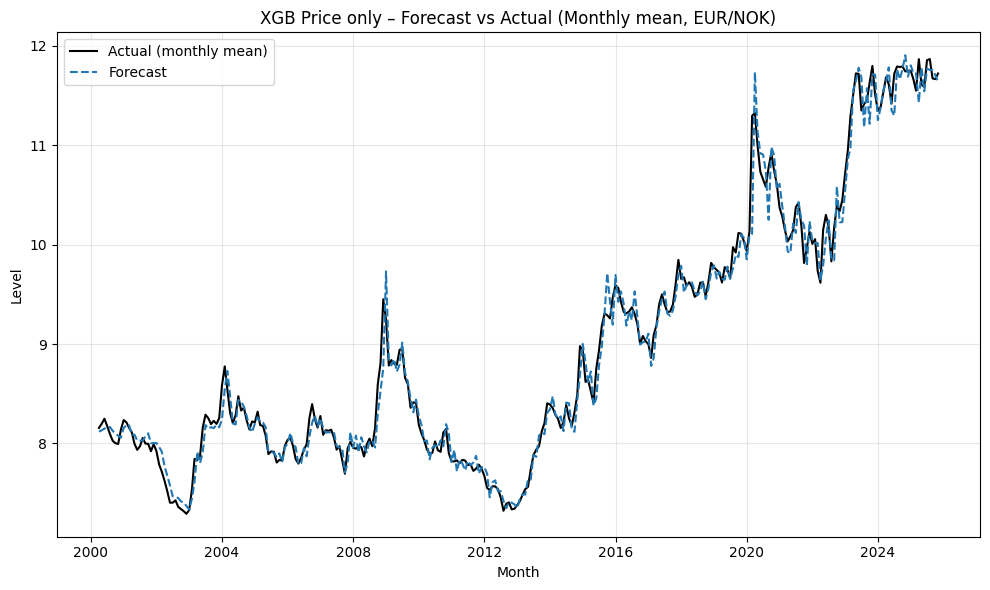

Saved: XGB_PriceOnly.png


In [8]:
# =========================================
# XGB Price only – EUR/NOK walk-forward (MONTHLY mean, levels)
# Uses helpers:
#   - load_fx_series_daily_and_business(...)
#   - last_trading_day(...)
#   - EVAL_MONTHLY["evaluate_period_df"], EVAL_MONTHLY["plot_period_simple"]
# Params:
#   - set BEST_PARAMS from your tuned output (and cap n_estimators<=150)
# Output:
#   - PNG: XGB_PriceOnly.png
# =========================================

from __future__ import annotations
import math
from dataclasses import dataclass
from typing import Dict, Optional, Tuple

import numpy as np
import pandas as pd
from xgboost import XGBRegressor
from joblib import Parallel, delayed


# -----------------------------
# Config
# -----------------------------
@dataclass
class CfgPO_M:
    series: str = "EUR_NOK"
    m_freq: str = "M"
    max_lags: int = 20
    max_horizon: int = 64
    min_hist_days: int = 40
    random_state: int = 42
    n_jobs_outer: int = -1
    fig_png: str = "XGB_PriceOnly.png"

CFG_PO_M = CfgPO_M()


# -----------------------------
# GPU helper (optional)
# -----------------------------
def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    # hard cap as per spec
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


# -----------------------------
# Lag features (univariate)
# -----------------------------
def make_lag_matrix_univariate(s_hist: pd.Series, max_lags: int) -> Tuple[np.ndarray, np.ndarray]:
    work = pd.DataFrame({"y": s_hist.astype(float)})
    for k in range(1, max_lags + 1):
        work[f"lag{k}"] = work["y"].shift(k)
    work = work.dropna()
    X = work[[f"lag{k}" for k in range(1, max_lags + 1)]].values
    y = work["y"].values
    return X, y


# -----------------------------
# Fit + recursive forecast
# -----------------------------
def fit_xgb_one_step_univariate(s_hist_daily: pd.Series, params: Dict) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix_univariate(s_hist_daily, CFG_PO_M.max_lags)
    if len(X) < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_PO_M.random_state,
        n_jobs=1,                      # avoid joblib oversubscription
        **xgb_gpu_kwargs(),            # remove if you want CPU-only
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast_univariate(model: XGBRegressor, s_hist_daily: pd.Series, H: int) -> pd.Series:
    hist = s_hist_daily.astype(float).copy()
    preds = []
    for _ in range(H):
        lags = hist.iloc[-CFG_PO_M.max_lags:][::-1].values
        yhat = float(model.predict(lags.reshape(1, -1))[0])
        preds.append(yhat)
        hist = pd.concat([hist, pd.Series([yhat], index=[hist.index[-1] + pd.Timedelta(days=1)])])
    return pd.Series(preds)


# -----------------------------
# Monthly walk-forward (parallel outer)
# -----------------------------
def walk_forward_price_only_monthly(
    S_b: pd.Series,
    S_d: pd.Series,
    params: Dict,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_m = pd.Period(S_b.index.min(), freq=CFG_PO_M.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=CFG_PO_M.m_freq)
    months = pd.period_range(first_m, last_m, freq=CFG_PO_M.m_freq)

    def _one_month(m: pd.Period):
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            return None

        hist_d = S_d.loc[:cut]
        if hist_d.size < CFG_PO_M.min_hist_days or hist_d.size <= CFG_PO_M.max_lags:
            return None

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])  # RW benchmark at cut (driftless)

        H = (m_end.date() - m_start.date()).days + 1
        if H <= 0 or H > CFG_PO_M.max_horizon:
            return None

        try:
            model = fit_xgb_one_step_univariate(hist_d, params)
            pf = recursive_daily_forecast_univariate(model, hist_d, H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_m_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "month": m,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_month(m) for m in months]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(
            delayed(_one_month)(m) for m in months
        )

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("month").sort_index()
    return df


# -----------------------------
# Run
# -----------------------------
S_b, S_d = load_fx_series_daily_and_business(
    DATA_CFG.url,
    series=CFG_PO_M.series,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)

period_df = walk_forward_price_only_monthly(
    S_b=S_b,
    S_d=S_d,
    params=BEST_PARAMS,
    n_jobs_outer=CFG_PO_M.n_jobs_outer,
)

core, res = EVAL_MONTHLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Price only (Monthly mean)",
    print_output=True,
)

EVAL_MONTHLY["plot_period_simple"](
    period_df,
    title="XGB Price only – Forecast vs Actual (Monthly mean, EUR/NOK)",
    png_path=CFG_PO_M.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


## Q


=== XGB Price only (Quarterly mean) (quarterly mean) ===
Observations: 103
RMSE (level): 0.220791
MAE  (level): 0.157985
Directional accuracy: 72/102 (70.6%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 0.8326
p-value     : 0.4050


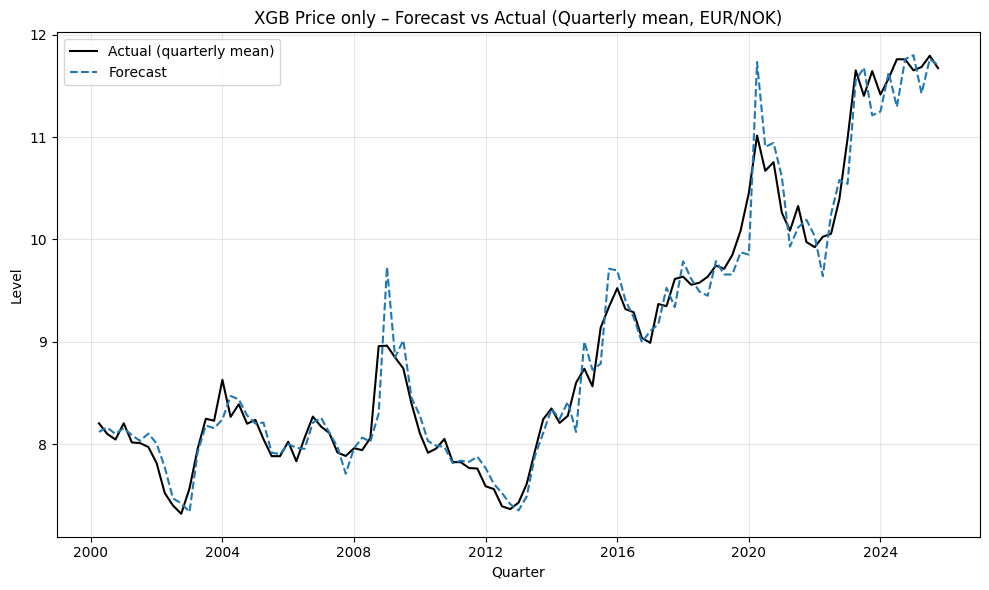

Saved: XGB_PriceOnly_Quarterly.png


In [12]:
# =========================================
# XGB Price only – EUR/NOK walk-forward (QUARTERLY mean, levels)
# Uses helpers:
#   - load_fx_series_daily_and_business(...)
#   - last_trading_day(...)
#   - EVAL_QUARTERLY["evaluate_period_df"], EVAL_QUARTERLY["plot_period_simple"]
# Core logic:
#   - Fit one-step XGB on daily lags up to cut (last B-day of previous quarter)
#   - Recursive daily forecast for full quarter calendar length
#   - Aggregate forecasts to quarterly mean over business days in the quarter
# Adds:
#   - cut_level (RW benchmark at cut) required by eval_common_quarterly
# =========================================

from __future__ import annotations
from dataclasses import dataclass
from typing import Dict, Optional, Tuple

import numpy as np
import pandas as pd
from xgboost import XGBRegressor
from joblib import Parallel, delayed


@dataclass
class CfgPO_Q:
    series: str = "EUR_NOK"
    q_freq: str = "Q-DEC"
    max_lags: int = 20
    max_horizon: int = 100
    min_hist_days: int = 40
    random_state: int = 42
    n_jobs_outer: int = -1
    fig_png: str = "XGB_PriceOnly_Quarterly.png"

CFG_PO_Q = CfgPO_Q()


def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


def make_lag_matrix_univariate(s_hist: pd.Series, max_lags: int) -> Tuple[np.ndarray, np.ndarray]:
    work = pd.DataFrame({"y": s_hist.astype(float)})
    for k in range(1, max_lags + 1):
        work[f"lag{k}"] = work["y"].shift(k)
    work = work.dropna()
    X = work[[f"lag{k}" for k in range(1, max_lags + 1)]].values
    y = work["y"].values
    return X, y


def fit_xgb_one_step_univariate(s_hist_daily: pd.Series, params: Dict) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix_univariate(s_hist_daily, CFG_PO_Q.max_lags)
    if len(X) < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_PO_Q.random_state,
        n_jobs=1,
        **xgb_gpu_kwargs(),
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast_univariate(model: XGBRegressor, s_hist_daily: pd.Series, H: int) -> pd.Series:
    hist = s_hist_daily.astype(float).copy()
    preds = []
    for _ in range(H):
        lags = hist.iloc[-CFG_PO_Q.max_lags:][::-1].values
        yhat = float(model.predict(lags.reshape(1, -1))[0])
        preds.append(yhat)
        hist = pd.concat([hist, pd.Series([yhat], index=[hist.index[-1] + pd.Timedelta(days=1)])])
    return pd.Series(preds)


def walk_forward_price_only_quarterly(
    S_b: pd.Series,
    S_d: pd.Series,
    params: Dict,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_q = pd.Period(S_b.index.min(), freq=CFG_PO_Q.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=CFG_PO_Q.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=CFG_PO_Q.q_freq)

    def _one_quarter(q: pd.Period):
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time

        cut = last_trading_day(S_b, prev_q.start_time, prev_q.end_time)
        if cut is None:
            return None

        hist_d = S_d.loc[:cut]
        if hist_d.size < CFG_PO_Q.min_hist_days or hist_d.size <= CFG_PO_Q.max_lags:
            return None

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])  # RW benchmark ved cut

        H = (q_end.date() - q_start.date()).days + 1
        if H <= 0 or H > CFG_PO_Q.max_horizon:
            return None

        try:
            model = fit_xgb_one_step_univariate(hist_d, params)
            pf = recursive_daily_forecast_univariate(model, hist_d, H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_q_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "quarter": q,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_quarter(q) for q in quarters]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(delayed(_one_quarter)(q) for q in quarters)

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("quarter").sort_index()
    return df


# -----------------------------
# Run
# -----------------------------
S_b, S_d = load_fx_series_daily_and_business(
    DATA_CFG.url,
    series=CFG_PO_Q.series,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)

period_df = walk_forward_price_only_quarterly(
    S_b=S_b,
    S_d=S_d,
    params=BEST_PARAMS,
    n_jobs_outer=CFG_PO_Q.n_jobs_outer,
)

core, res = EVAL_QUARTERLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Price only (Quarterly mean)",
    print_output=True,
)

EVAL_QUARTERLY["plot_period_simple"](
    period_df,
    title="XGB Price only – Forecast vs Actual (Quarterly mean, EUR/NOK)",
    png_path=CFG_PO_Q.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


# EN

## M


=== XGB Macro (Monthly mean) (monthly mean) ===
Observations: 308
RMSE (level): 0.161500
MAE  (level): 0.102356
Directional accuracy: 216/307 (70.4%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.5223
p-value     : 0.1279


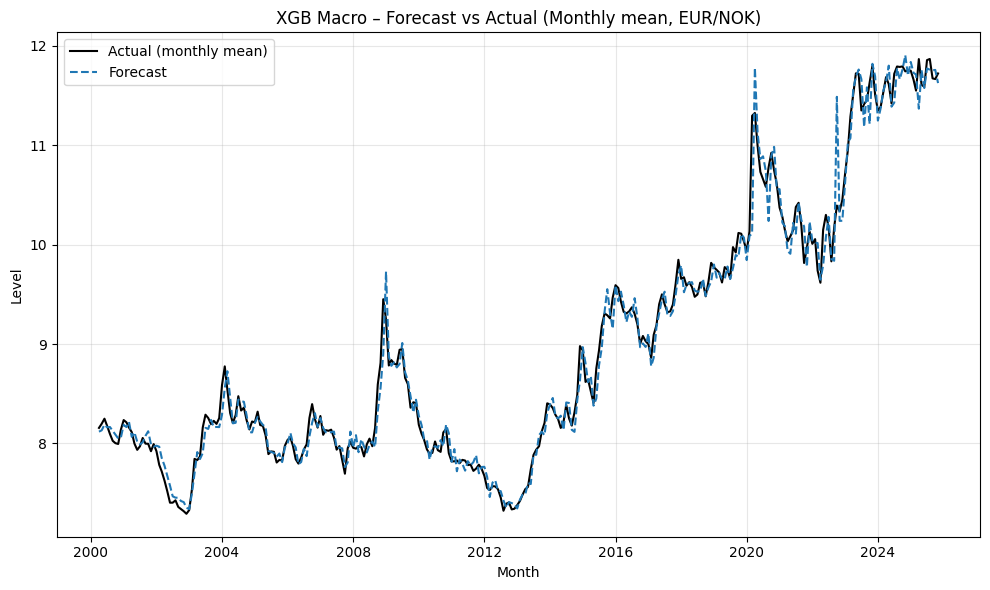

Saved: XGB_MacroMonthly.png


In [13]:
# =========================================
# XGB Macro Monthly – EUR/NOK walk-forward (monthly mean, levels) with past-only daily macro covariates
# Uses helpers:
#   - DATA_CFG + download_csv_text (from your helpers) OR direct read below
#   - last_trading_day(...)
#   - EVAL_MONTHLY["evaluate_period_df"], EVAL_MONTHLY["plot_period_simple"]
# Key:
#   - Target: EUR_NOK
#   - Macros: Q, d_pi, dI_t (frozen during recursion)
#   - Adds cut_level (RW at cut) required by eval_common_monthly
# =========================================

from __future__ import annotations
from dataclasses import dataclass
from typing import Dict, List, Optional, Tuple

import io
import numpy as np
import pandas as pd
import requests, certifi
from xgboost import XGBRegressor
from joblib import Parallel, delayed


# -----------------------------
# Config
# -----------------------------
@dataclass
class CfgMacroM:
    url: str = DATA_CFG.url
    series: str = "EUR_NOK"
    macro_cols: Tuple[str, ...] = ("Q", "d_pi", "dI_t")

    m_freq: str = "M"
    max_lags: int = 20
    max_horizon: int = 64
    min_hist_days: int = 40

    random_state: int = 42
    n_jobs_outer: int = -1

    fig_png: str = "XGB_MacroMonthly.png"

CFG_MM = CfgMacroM()


def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


# -----------------------------
# Load daily panel: EUR_NOK + macros
# -----------------------------
def load_target_and_macros_daily(url: str, series: str, macro_cols: Tuple[str, ...]) -> Tuple[pd.Series, pd.DataFrame]:
    """
    Returns:
      S_b  : EUR_NOK business-day series (B) ffilled (cuts/truth base)
      DF_d : daily calendar panel (D) ffilled with columns [EUR_NOK] + macro_cols
    """
    # use your helper download_csv_text if you prefer; this is self-contained
    text = download_csv_text(url, retries=DATA_CFG.retries, timeout=DATA_CFG.timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date", series, *macro_cols}
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[list(required)]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE", series])
        .sort_values("DATE")
        .set_index("DATE")
    )

    for c in [series, *macro_cols]:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.dropna(subset=[series])
    if df.empty:
        raise ValueError("Empty after cleaning.")

    # EUR/NOK B-days for cut + realized aggregation base
    S_b = df[series].asfreq("B").ffill().astype(float)
    S_b.name = series

    # daily calendar panel for training + recursion
    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    DF_d = df.reindex(full_idx).ffill()
    DF_d.index.name = "DATE"

    return S_b, DF_d


# -----------------------------
# Feature engineering: stacked lags
# -----------------------------
def make_lag_matrix(df_hist: pd.DataFrame, max_lags: int, series: str, macro_cols: Tuple[str, ...]) -> Tuple[np.ndarray, np.ndarray]:
    """
    X_t stacks: [EUR_NOK_lags, Q_lags, d_pi_lags, dI_t_lags] (each 1..L)
    y_t = EUR_NOK_t
    """
    cols = [series, *macro_cols]
    work = df_hist[cols].copy()

    lag_cols: List[str] = []
    for var in cols:
        for k in range(1, max_lags + 1):
            cn = f"{var}_lag{k}"
            work[cn] = work[var].shift(k)
            lag_cols.append(cn)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[series].to_numpy()
    return X, y


# -----------------------------
# Fit + recursive forecast (macros frozen)
# -----------------------------
def fit_xgb_one_step(df_hist_daily: pd.DataFrame, params: Dict) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix(df_hist_daily, CFG_MM.max_lags, CFG_MM.series, CFG_MM.macro_cols)
    if X.shape[0] < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_MM.random_state,
        n_jobs=1,
        **xgb_gpu_kwargs(),
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, H: int) -> pd.Series:
    hist = df_hist_daily[[CFG_MM.series, *CFG_MM.macro_cols]].copy()
    frozen_macros = hist[list(CFG_MM.macro_cols)].iloc[-1].to_dict()

    preds: List[float] = []
    for _ in range(H):
        if len(hist) < CFG_MM.max_lags:
            raise ValueError("Not enough history for lags.")

        feat: List[float] = []
        for var in [CFG_MM.series, *CFG_MM.macro_cols]:
            feat.extend(hist[var].iloc[-CFG_MM.max_lags:][::-1].to_numpy(dtype=float).tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = {CFG_MM.series: yhat, **frozen_macros}
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)


# -----------------------------
# Monthly walk-forward (parallel) + cut_level
# -----------------------------
def walk_forward_macro_monthly(
    S_b: pd.Series,
    DF_d: pd.DataFrame,
    params: Dict,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_m = pd.Period(S_b.index.min(), freq=CFG_MM.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=CFG_MM.m_freq)
    months = pd.period_range(first_m, last_m, freq=CFG_MM.m_freq)

    def _one_month(m: pd.Period):
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            return None

        hist_df = DF_d.loc[:cut]
        if hist_df.shape[0] < CFG_MM.min_hist_days or hist_df.shape[0] <= CFG_MM.max_lags:
            return None

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])  # REQUIRED by eval_common_monthly

        H = (m_end.date() - m_start.date()).days + 1
        if H <= 0 or H > CFG_MM.max_horizon:
            return None

        try:
            model = fit_xgb_one_step(hist_df, params)
            pf = recursive_daily_forecast(model, hist_df, H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_m_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "month": m,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_month(m) for m in months]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(delayed(_one_month)(m) for m in months)

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("month").sort_index()
    return df


# -----------------------------
# Run + evaluate + plot (monthly common helpers)
# -----------------------------
S_b, DF_d = load_target_and_macros_daily(CFG_MM.url, CFG_MM.series, CFG_MM.macro_cols)

period_df = walk_forward_macro_monthly(
    S_b=S_b,
    DF_d=DF_d,
    params=BEST_PARAMS,
    n_jobs_outer=CFG_MM.n_jobs_outer
)

core, res = EVAL_MONTHLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Macro (Monthly mean)",
    print_output=True,
)

EVAL_MONTHLY["plot_period_simple"](
    period_df,
    title="XGB Macro – Forecast vs Actual (Monthly mean, EUR/NOK)",
    png_path=CFG_MM.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


## Q


=== XGB Macro (Quarterly mean) (quarterly mean) ===
Observations: 103
RMSE (level): 0.237246
MAE  (level): 0.160171
Directional accuracy: 74/102 (72.5%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 0.9226
p-value     : 0.3562


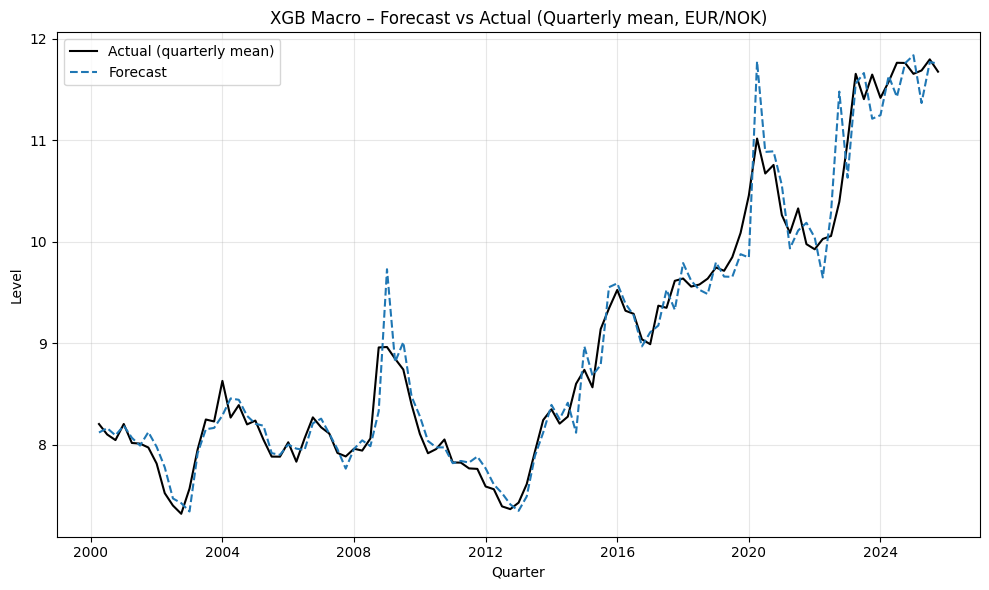

Saved: XGB_MacroQuarterly.png


In [14]:
# =========================================
# XGB Macro Quarterly – EUR/NOK walk-forward (quarterly mean, levels) with past-only daily macro covariates
# Uses helpers:
#   - DATA_CFG.url + download_csv_text(...)
#   - last_trading_day(...)
#   - EVAL_QUARTERLY["evaluate_period_df"], EVAL_QUARTERLY["plot_period_simple"]
# Key:
#   - Target: EUR_NOK
#   - Macros: Q, d_pi, dI_t (frozen during recursion; no future macro paths)
#   - Adds cut_level (RW at cut) required by eval_common_quarterly
# =========================================

from __future__ import annotations
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import io
import numpy as np
import pandas as pd
from xgboost import XGBRegressor
from joblib import Parallel, delayed


# -----------------------------
# Config
# -----------------------------
@dataclass
class CfgMacroQ:
    url: str = DATA_CFG.url
    series: str = "EUR_NOK"
    macro_cols: Tuple[str, ...] = ("Q", "d_pi", "dI_t")

    q_freq: str = "Q-DEC"
    max_lags: int = 20
    max_horizon: int = 128
    min_hist_days: int = 40

    random_state: int = 42
    n_jobs_outer: int = -1

    fig_png: str = "XGB_MacroQuarterly.png"

CFG_MQ = CfgMacroQ()


def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


# -----------------------------
# Load daily target + macros
# -----------------------------
def load_target_and_macros_daily(url: str, series: str, macro_cols: Tuple[str, ...]) -> Tuple[pd.Series, pd.DataFrame]:
    """
    Returns:
      S_b  : EUR_NOK business-day series (B) ffilled (cuts/truth base)
      DF_d : daily calendar panel (D) ffilled with columns [EUR_NOK] + macro_cols
    """
    text = download_csv_text(url, retries=DATA_CFG.retries, timeout=DATA_CFG.timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date", series, *macro_cols}
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[list(required)]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE", series])
        .sort_values("DATE")
        .set_index("DATE")
    )

    for c in [series, *macro_cols]:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.dropna(subset=[series])
    if df.empty:
        raise ValueError("Empty after cleaning.")

    S_b = df[series].asfreq("B").ffill().astype(float)
    S_b.name = series

    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    DF_d = df.reindex(full_idx).ffill()
    DF_d.index.name = "DATE"

    return S_b, DF_d


# -----------------------------
# Lag matrix: stacked lags (target + macros)
# -----------------------------
def make_lag_matrix(df_hist: pd.DataFrame, max_lags: int, series: str, macro_cols: Tuple[str, ...]) -> Tuple[np.ndarray, np.ndarray]:
    cols = [series, *macro_cols]
    work = df_hist[cols].copy()

    lag_cols: List[str] = []
    for var in cols:
        for k in range(1, max_lags + 1):
            cn = f"{var}_lag{k}"
            work[cn] = work[var].shift(k)
            lag_cols.append(cn)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[series].to_numpy()
    return X, y


# -----------------------------
# Fit + recursive forecast (macros frozen)
# -----------------------------
def fit_xgb_one_step(df_hist_daily: pd.DataFrame, params: Dict) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix(df_hist_daily, CFG_MQ.max_lags, CFG_MQ.series, CFG_MQ.macro_cols)
    if X.shape[0] < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_MQ.random_state,
        n_jobs=1,
        **xgb_gpu_kwargs(),
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, H: int) -> pd.Series:
    hist = df_hist_daily[[CFG_MQ.series, *CFG_MQ.macro_cols]].copy()
    frozen_macros = hist[list(CFG_MQ.macro_cols)].iloc[-1].to_dict()

    preds: List[float] = []
    for _ in range(H):
        if len(hist) < CFG_MQ.max_lags:
            raise ValueError("Not enough history for lags.")

        feat: List[float] = []
        for var in [CFG_MQ.series, *CFG_MQ.macro_cols]:
            feat.extend(hist[var].iloc[-CFG_MQ.max_lags:][::-1].to_numpy(dtype=float).tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = {CFG_MQ.series: yhat, **frozen_macros}
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)


# -----------------------------
# Quarterly walk-forward (parallel) + cut_level
# -----------------------------
def walk_forward_macro_quarterly(
    S_b: pd.Series,
    DF_d: pd.DataFrame,
    params: Dict,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_q = pd.Period(S_b.index.min(), freq=CFG_MQ.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=CFG_MQ.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=CFG_MQ.q_freq)

    def _one_quarter(q: pd.Period):
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time

        cut = last_trading_day(S_b, prev_q.start_time, prev_q.end_time)
        if cut is None:
            return None

        hist_df = DF_d.loc[:cut]
        if hist_df.shape[0] < CFG_MQ.min_hist_days or hist_df.shape[0] <= CFG_MQ.max_lags:
            return None

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])  # REQUIRED by eval_common_quarterly

        H = (q_end.date() - q_start.date()).days + 1
        if H <= 0 or H > CFG_MQ.max_horizon:
            return None

        try:
            model = fit_xgb_one_step(hist_df, params)
            pf = recursive_daily_forecast(model, hist_df, H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_q_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "quarter": q,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_quarter(q) for q in quarters]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(delayed(_one_quarter)(q) for q in quarters)

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("quarter").sort_index()
    return df


# -----------------------------
# Run + evaluate + plot (quarterly common helpers)
# -----------------------------
S_b, DF_d = load_target_and_macros_daily(CFG_MQ.url, CFG_MQ.series, CFG_MQ.macro_cols)

period_df = walk_forward_macro_quarterly(
    S_b=S_b,
    DF_d=DF_d,
    params=BEST_PARAMS,
    n_jobs_outer=CFG_MQ.n_jobs_outer
)

core, res = EVAL_QUARTERLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Macro (Quarterly mean)",
    print_output=True,
)

EVAL_QUARTERLY["plot_period_simple"](
    period_df,
    title="XGB Macro – Forecast vs Actual (Quarterly mean, EUR/NOK)",
    png_path=CFG_MQ.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


# EN-EX

## M


=== XGB Panel (Monthly mean) (monthly mean) ===
Observations: 308
RMSE (level): 0.149396
MAE  (level): 0.100314
Directional accuracy: 206/307 (67.1%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.3295
p-value     : 0.1837


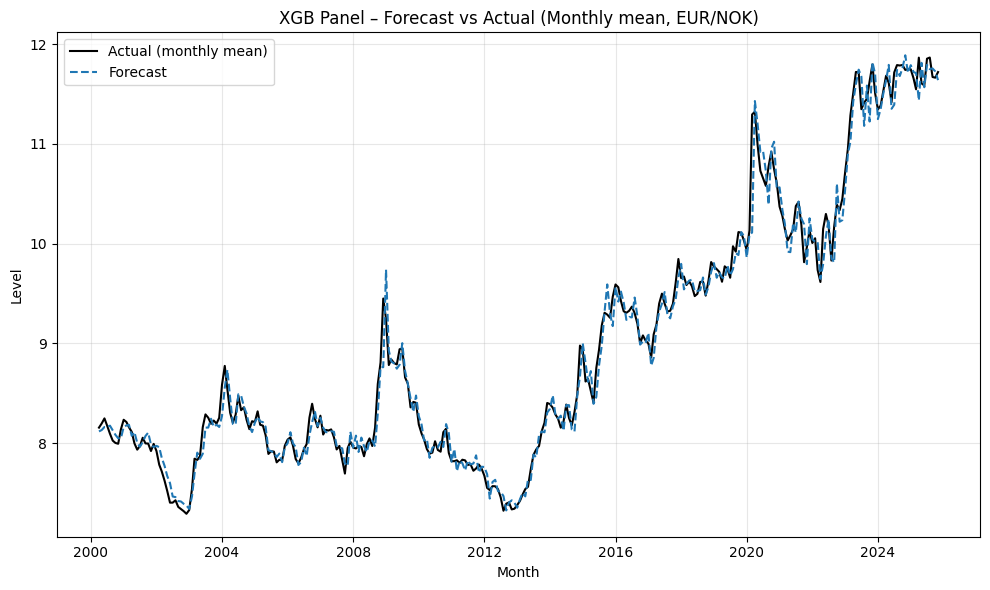

Saved: XGB_PanelMonthly.png


In [15]:
# =========================================
# XGB Panel Monthly – EUR/NOK walk-forward (monthly mean, levels) with daily panel + macro covariates (past-only)
# Uses helpers:
#   - DATA_CFG.url + download_csv_text(...)
#   - last_trading_day(...)
#   - EVAL_MONTHLY["evaluate_period_df"], EVAL_MONTHLY["plot_period_simple"]
# Key:
#   - Target: EUR_NOK
#   - Predictors (lagged): EUR_NOK + panel series + macros
#   - Frozen during recursion: all predictors except EUR_NOK
#   - Adds cut_level (RW at cut) required by eval_common_monthly
# =========================================

from __future__ import annotations
from dataclasses import dataclass
from typing import Dict, List, Tuple

import io
import numpy as np
import pandas as pd
from xgboost import XGBRegressor
from joblib import Parallel, delayed


# -----------------------------
# Config
# -----------------------------
@dataclass
class CfgPanelM:
    url: str = DATA_CFG.url
    target: str = "EUR_NOK"

    panel_series: Tuple[str, ...] = (
        "EUR_NOK",
        "Brent",
        "VIX",
        "StoxEurope",
        "SP500",
        "OSEBX",
        "OBX_Energy",
    )
    macro_cols: Tuple[str, ...] = ("Q", "d_pi", "dI_t")

    m_freq: str = "M"
    max_lags: int = 20
    max_horizon: int = 64
    min_hist_days: int = 40

    random_state: int = 42
    n_jobs_outer: int = -1

    fig_png: str = "XGB_PanelMonthly.png"

CFG_PM = CfgPanelM()
ALL_PREDICTORS = list(CFG_PM.panel_series) + list(CFG_PM.macro_cols)


def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


# -----------------------------
# Load daily wide DF + business-day EUR_NOK
# -----------------------------
def load_panel_daily(url: str, predictors: List[str], target: str) -> Tuple[pd.Series, pd.DataFrame]:
    """
    Returns:
      S_b  : target on business days (B) ffilled (cuts/truth base)
      DF_d : daily calendar panel (D) ffilled with columns predictors
    """
    text = download_csv_text(url, retries=DATA_CFG.retries, timeout=DATA_CFG.timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date", *predictors}
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[list(required)]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE", target])
        .sort_values("DATE")
        .set_index("DATE")
    )

    for c in predictors:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.dropna(subset=[target])
    if df.empty:
        raise ValueError("Empty after cleaning.")

    S_b = df[target].asfreq("B").ffill().astype(float)
    S_b.name = target

    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    DF_d = df.reindex(full_idx).ffill()
    DF_d.index.name = "DATE"

    return S_b, DF_d


# -----------------------------
# Lag matrix: stacked lags across all predictors
# -----------------------------
def make_lag_matrix(df_hist: pd.DataFrame, predictors: List[str], max_lags: int, target: str) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[predictors].copy()

    lag_cols: List[str] = []
    for var in predictors:
        for k in range(1, max_lags + 1):
            cn = f"{var}_lag{k}"
            work[cn] = work[var].shift(k)
            lag_cols.append(cn)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[target].to_numpy()
    return X, y


# -----------------------------
# Fit + recursive forecast (freeze non-target predictors)
# -----------------------------
def fit_xgb_one_step(df_hist_daily: pd.DataFrame, params: Dict, predictors: List[str], target: str) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix(df_hist_daily, predictors, CFG_PM.max_lags, target)
    if X.shape[0] < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_PM.random_state,
        n_jobs=1,
        **xgb_gpu_kwargs(),
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, H: int, predictors: List[str], target: str) -> pd.Series:
    hist = df_hist_daily[predictors].copy()
    frozen = hist.iloc[-1].to_dict()

    preds: List[float] = []
    for _ in range(H):
        if len(hist) < CFG_PM.max_lags:
            raise ValueError("Not enough history for lags.")

        feat: List[float] = []
        for var in predictors:
            feat.extend(hist[var].iloc[-CFG_PM.max_lags:][::-1].to_numpy(dtype=float).tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = frozen.copy()
        new_row[target] = yhat
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)


# -----------------------------
# Monthly walk-forward (parallel) + cut_level
# -----------------------------
def walk_forward_panel_monthly(
    S_b: pd.Series,
    DF_d: pd.DataFrame,
    params: Dict,
    predictors: List[str],
    target: str,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_m = pd.Period(S_b.index.min(), freq=CFG_PM.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=CFG_PM.m_freq)
    months = pd.period_range(first_m, last_m, freq=CFG_PM.m_freq)

    def _one_month(m: pd.Period):
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            return None

        hist_df = DF_d.loc[:cut]
        if hist_df.shape[0] < CFG_PM.min_hist_days or hist_df.shape[0] <= CFG_PM.max_lags:
            return None

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])  # REQUIRED by eval_common_monthly

        H = (m_end.date() - m_start.date()).days + 1
        if H <= 0 or H > CFG_PM.max_horizon:
            return None

        try:
            model = fit_xgb_one_step(hist_df, params, predictors, target)
            pf = recursive_daily_forecast(model, hist_df, H, predictors, target)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_m_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "month": m,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_month(m) for m in months]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(delayed(_one_month)(m) for m in months)

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("month").sort_index()
    return df


# -----------------------------
# Run + evaluate + plot
# -----------------------------
S_b, DF_d = load_panel_daily(CFG_PM.url, ALL_PREDICTORS, CFG_PM.target)

period_df = walk_forward_panel_monthly(
    S_b=S_b,
    DF_d=DF_d,
    params=BEST_PARAMS,
    predictors=ALL_PREDICTORS,
    target=CFG_PM.target,
    n_jobs_outer=CFG_PM.n_jobs_outer
)

core, res = EVAL_MONTHLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Panel (Monthly mean)",
    print_output=True,
)

EVAL_MONTHLY["plot_period_simple"](
    period_df,
    title="XGB Panel – Forecast vs Actual (Monthly mean, EUR/NOK)",
    png_path=CFG_PM.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


## Q


=== XGB Panel (Quarterly mean) (quarterly mean) ===
Observations: 103
RMSE (level): 0.206629
MAE  (level): 0.150391
Directional accuracy: 75/102 (73.5%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: -0.8990
p-value     : 0.3687


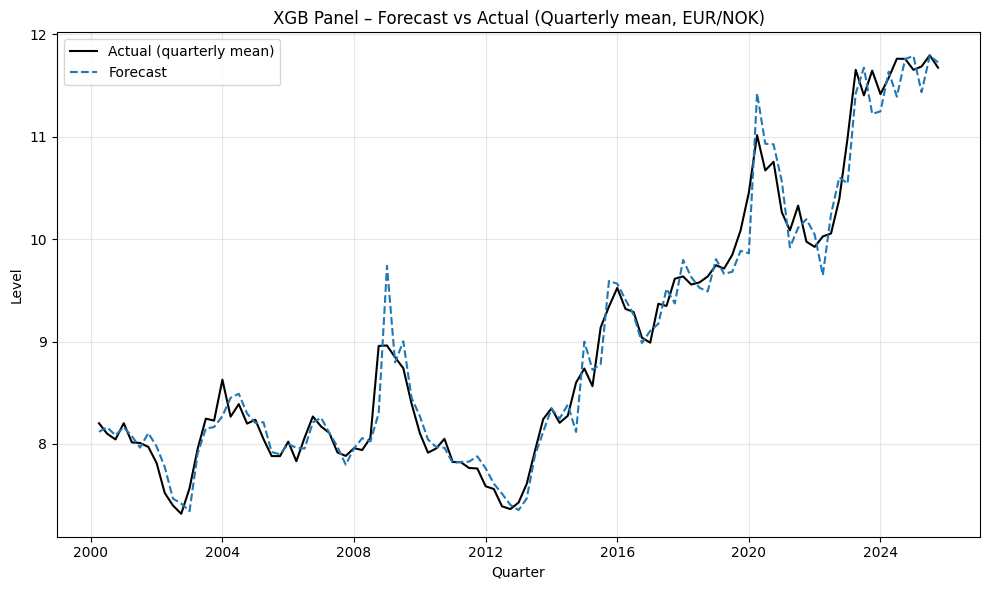

Saved: XGB_PanelQuarterly.png


In [16]:
# =========================================
# XGB Panel Quarterly – EUR/NOK walk-forward (quarterly mean, levels) with daily panel + macro covariates (past-only)
# Uses helpers:
#   - DATA_CFG.url + download_csv_text(...)
#   - last_trading_day(...)
#   - EVAL_QUARTERLY["evaluate_period_df"], EVAL_QUARTERLY["plot_period_simple"]
# Key:
#   - Target: EUR_NOK
#   - Predictors (lagged): EUR_NOK + panel series + macros
#   - Frozen during recursion: all predictors except EUR_NOK
#   - Adds cut_level (RW at cut) required by eval_common_quarterly
# =========================================

from __future__ import annotations
from dataclasses import dataclass
from typing import Dict, List, Tuple

import io
import numpy as np
import pandas as pd
from xgboost import XGBRegressor
from joblib import Parallel, delayed


# -----------------------------
# Config
# -----------------------------
@dataclass
class CfgPanelQ:
    url: str = DATA_CFG.url
    target: str = "EUR_NOK"

    panel_series: Tuple[str, ...] = (
        "EUR_NOK",
        "Brent",
        "VIX",
        "StoxEurope",
        "SP500",
        "OSEBX",
        "OBX_Energy",
    )
    macro_cols: Tuple[str, ...] = ("Q", "d_pi", "dI_t")

    q_freq: str = "Q-DEC"
    max_lags: int = 20
    max_horizon: int = 128
    min_hist_days: int = 40

    random_state: int = 42
    n_jobs_outer: int = -1

    fig_png: str = "XGB_PanelQuarterly.png"

CFG_PQ = CfgPanelQ()
ALL_PREDICTORS = list(CFG_PQ.panel_series) + list(CFG_PQ.macro_cols)


def xgb_gpu_kwargs() -> Dict:
    import xgboost
    ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
    if ver >= (2, 0):
        return {"tree_method": "hist", "device": "cuda"}
    else:
        return {"tree_method": "gpu_hist"}


# -----------------------------
# Params (best from tuning)
# -----------------------------
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}


def sanitize_params(p: Dict) -> Dict:
    p = p.copy()
    if "n_estimators" in p: p["n_estimators"] = int(round(p["n_estimators"]))
    if "max_depth" in p: p["max_depth"] = int(round(p["max_depth"]))
    for k in ["min_child_weight","learning_rate","subsample","colsample_bytree","gamma","reg_alpha","reg_lambda"]:
        if k in p: p[k] = float(p[k])
    if "n_estimators" in p:
        p["n_estimators"] = min(p["n_estimators"], 150)
    return p


# -----------------------------
# Load daily wide DF + business-day EUR_NOK
# -----------------------------
def load_panel_daily(url: str, predictors: List[str], target: str) -> Tuple[pd.Series, pd.DataFrame]:
    """
    Returns:
      S_b  : target on business days (B) ffilled (cuts/truth base)
      DF_d : daily calendar panel (D) ffilled with columns predictors
    """
    text = download_csv_text(url, retries=DATA_CFG.retries, timeout=DATA_CFG.timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date", *predictors}
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[list(required)]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE", target])
        .sort_values("DATE")
        .set_index("DATE")
    )

    for c in predictors:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.dropna(subset=[target])
    if df.empty:
        raise ValueError("Empty after cleaning.")

    S_b = df[target].asfreq("B").ffill().astype(float)
    S_b.name = target

    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    DF_d = df.reindex(full_idx).ffill()
    DF_d.index.name = "DATE"

    return S_b, DF_d


# -----------------------------
# Lag matrix: stacked lags across predictors
# -----------------------------
def make_lag_matrix(df_hist: pd.DataFrame, predictors: List[str], max_lags: int, target: str) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[predictors].copy()

    lag_cols: List[str] = []
    for var in predictors:
        for k in range(1, max_lags + 1):
            cn = f"{var}_lag{k}"
            work[cn] = work[var].shift(k)
            lag_cols.append(cn)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[target].to_numpy()
    return X, y


# -----------------------------
# Fit + recursive forecast (freeze non-target predictors)
# -----------------------------
def fit_xgb_one_step(df_hist_daily: pd.DataFrame, params: Dict, predictors: List[str], target: str) -> XGBRegressor:
    params = sanitize_params(params)
    X, y = make_lag_matrix(df_hist_daily, predictors, CFG_PQ.max_lags, target)
    if X.shape[0] < 30:
        raise ValueError("Too few observations after lagging.")

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=CFG_PQ.random_state,
        n_jobs=1,
        **xgb_gpu_kwargs(),
        **params
    )
    model.fit(X, y)
    return model


def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, H: int, predictors: List[str], target: str) -> pd.Series:
    hist = df_hist_daily[predictors].copy()
    frozen = hist.iloc[-1].to_dict()  # snapshot of predictors at cut

    preds: List[float] = []
    for _ in range(H):
        if len(hist) < CFG_PQ.max_lags:
            raise ValueError("Not enough history for lags.")

        feat: List[float] = []
        for var in predictors:
            feat.extend(hist[var].iloc[-CFG_PQ.max_lags:][::-1].to_numpy(dtype=float).tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = frozen.copy()
        new_row[target] = yhat
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)


# -----------------------------
# Quarterly walk-forward (parallel) + cut_level
# -----------------------------
def walk_forward_panel_quarterly(
    S_b: pd.Series,
    DF_d: pd.DataFrame,
    params: Dict,
    predictors: List[str],
    target: str,
    n_jobs_outer: int = -1
) -> pd.DataFrame:
    params = sanitize_params(params)

    first_q = pd.Period(S_b.index.min(), freq=CFG_PQ.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=CFG_PQ.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=CFG_PQ.q_freq)

    def _one_quarter(q: pd.Period):
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time

        cut = last_trading_day(S_b, prev_q.start_time, prev_q.end_time)
        if cut is None:
            return None

        hist_df = DF_d.loc[:cut]
        if hist_df.shape[0] < CFG_PQ.min_hist_days or hist_df.shape[0] <= CFG_PQ.max_lags:
            return None

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            return None

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])  # REQUIRED by eval_common_quarterly

        H = (q_end.date() - q_start.date()).days + 1
        if H <= 0 or H > CFG_PQ.max_horizon:
            return None

        try:
            model = fit_xgb_one_step(hist_df, params, predictors, target)
            pf = recursive_daily_forecast(model, hist_df, H, predictors, target)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx)

            pred_b = pred_daily.reindex(idx_q_b, method=None)
            if pred_b.isna().all():
                return None

            y_pred = float(pred_b.dropna().mean())

            return {
                "quarter": q,
                "cut": cut,
                "cut_level": cut_level,
                "y_true": y_true,
                "y_pred": y_pred,
            }
        except Exception:
            return None

    if n_jobs_outer == 1:
        rows = [_one_quarter(q) for q in quarters]
    else:
        rows = Parallel(n_jobs=n_jobs_outer, backend="loky")(delayed(_one_quarter)(q) for q in quarters)

    rows = [r for r in rows if r is not None]
    df = pd.DataFrame(rows)
    if not df.empty:
        df = df.set_index("quarter").sort_index()
    return df


# -----------------------------
# Run + evaluate + plot
# -----------------------------
S_b, DF_d = load_panel_daily(CFG_PQ.url, ALL_PREDICTORS, CFG_PQ.target)

period_df = walk_forward_panel_quarterly(
    S_b=S_b,
    DF_d=DF_d,
    params=BEST_PARAMS,
    predictors=ALL_PREDICTORS,
    target=CFG_PQ.target,
    n_jobs_outer=CFG_PQ.n_jobs_outer
)

core, res = EVAL_QUARTERLY["evaluate_period_df"](
    period_df,
    loss="mse",
    h=1,
    label="XGB Panel (Quarterly mean)",
    print_output=True,
)

EVAL_QUARTERLY["plot_period_simple"](
    period_df,
    title="XGB Panel – Forecast vs Actual (Quarterly mean, EUR/NOK)",
    png_path=CFG_PQ.fig_png,
    pdf_path=None,
    y_label="Level",
    show=True,
)


# Variable Importance

In [22]:
def load_daily_covariates(
    url: str,
    cov_cols: list,
    retries: int = 3,
    timeout: int = 60,
) -> pd.DataFrame:
    """
    Load daily covariates from same CSV (expects 'Date' + cov_cols).
    Returns a calendar-day indexed DataFrame (freq='D') with forward-filled values.
    """
    text = download_csv_text(url, retries, timeout)
    raw = pd.read_csv(io.StringIO(text))

    required = {"Date"} | set(cov_cols)
    missing = required - set(raw.columns)
    if missing:
        raise ValueError(f"Missing columns in CSV: {missing}. Got: {list(raw.columns)}")

    df = (
        raw[["Date"] + list(cov_cols)]
        .rename(columns={"Date": "DATE"})
        .assign(DATE=lambda x: pd.to_datetime(x["DATE"], errors="coerce"))
        .dropna(subset=["DATE"])
        .sort_values("DATE")
        .set_index("DATE")
    )

    # numeric coercion + ffill
    for c in cov_cols:
        df[c] = pd.to_numeric(df[c], errors="coerce")
    df = df.ffill()

    # force calendar-day grid so joins with S_d work cleanly
    full_idx = pd.date_range(df.index.min(), df.index.max(), freq="D")
    df = df.reindex(full_idx).ffill()
    df.index.name = "DATE"

    return df


## M

### Phase 0

Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40

=== XGBoost (BEST_PARAMS) – past covariates (frozen in recursion) (monthly mean) ===
Observations: 308
RMSE (level): 0.149396
MAE  (level): 0.100314
Directional accuracy: 206/307 (67.1%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.3295
p-value     : 0.1837


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-861677244.py:84: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<40
  2000-03: hist<40

=== Robust LOO (locked months): rank by ΔDM-stat (higher = worse when removed) ===
 covariate  n_months  dm_stat  dm_ci_lo  dm_ci_hi  delta_dm_vs_base   mean_d  mean_d_ci_lo  mean_d_ci_hi  delta_mean_d_vs_base
       VIX       308 1.909616  0.619630  2.873483          0.580125 0.004681      0.000663      0.010333              0.001783
         Q       308 1.590239  0.437510  2.829777          0.260749 0.003497      0.000580      0.008357              0.000598
     Brent       308 1.464432  0.268675  2.645611          0.134942 0.003226      0.000331      0.008901              0.000327
     OSEBX       308 1.376252  0.175340  2.798081          0.046761 0.003039      0.000205      0.007711              0.000141
OBX_Energy       308 1.343985 -0.016758  2.363005          0.014494 0.002938     -0.000021      0.007321              0.000040
StoxEurope       308 1.339651 -0.185613  2.447071     

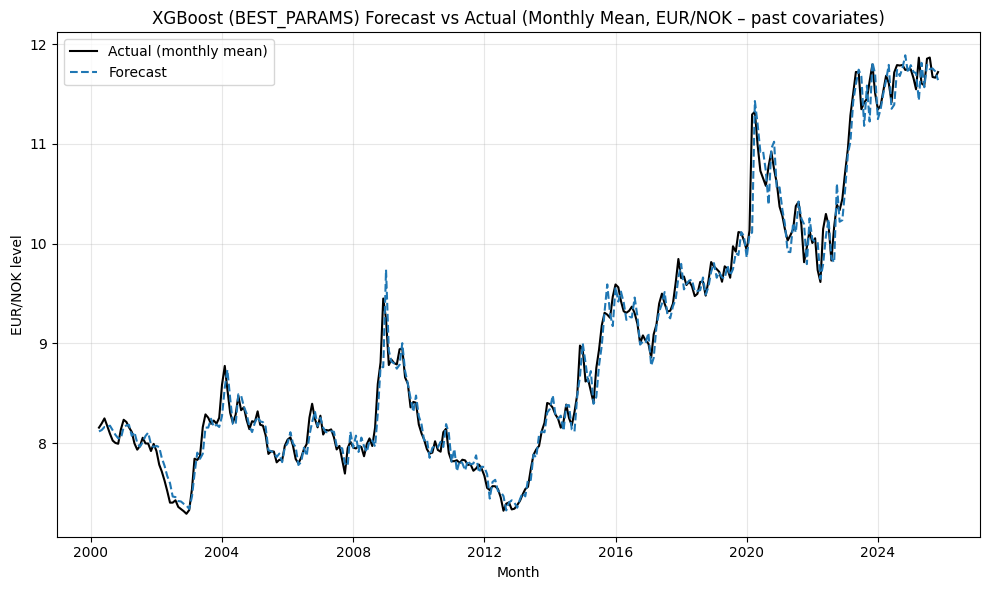

Saved: XGB_M_LOO.png

DONE: core_xgb, res_xgb, loo_xgb, period_df_base are in memory.


In [23]:
# ============================
# ONE-CELL: XGBoost (BEST_PARAMS) -> Monthly baseline -> Robust LOO (same as Chronos cell)
# Requires already in notebook:
#   - download_csv_text, DATA_CFG
#   - load_fx_series_daily_and_business, last_trading_day
#   - load_daily_covariates
#   - EVAL_MONTHLY (evaluate_period_df + plot_period_simple)
# ============================

import warnings
from dataclasses import dataclass
from typing import Dict, List, Callable, Tuple, Optional

import numpy as np
import pandas as pd
from xgboost import XGBRegressor

warnings.filterwarnings("ignore", category=FutureWarning)

# -----------------------------
# Config (match your Chronos cell)
# -----------------------------
TARGET_SERIES = "EUR_NOK"
EXOG_COLS  = ["Brent", "VIX", "StoxEurope", "SP500", "OSEBX", "OBX_Energy"]
MACRO_COLS = ["Q", "d_pi", "dI_t"]
ALL_COV_COLS = EXOG_COLS + MACRO_COLS

BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}

@dataclass
class CFG_M:
    m_freq: str = "M"
    min_hist_days: int = 40
    max_lags: int = 20
    max_horizon: int = 64
    verbose: bool = True
    # robustness knobs
    loss: str = "mse"
    h_dm: int = 1
    block_len: int = 12     # months per bootstrap block
    n_boot: int = 500
    random_seed: int = 123

CFG = CFG_M()

# -----------------------------
# XGB version-safe GPU kwargs (optional)
# -----------------------------
def _xgb_device_kwargs() -> Dict:
    try:
        import xgboost
        ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
        if ver >= (2, 0):
            return {"tree_method": "hist", "device": "cuda"}
        return {"tree_method": "gpu_hist"}
    except Exception:
        return {"tree_method": "hist"}

# -----------------------------
# Feature builder (lags of target + covariates)
# -----------------------------
def make_lag_matrix(
    df_hist: pd.DataFrame,
    target: str,
    predictors: List[str],
    L: int
) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[[target] + predictors].copy()
    lag_cols: List[str] = []

    for v in [target] + predictors:
        for k in range(1, L + 1):
            c = f"{v}_lag{k}"
            work[c] = work[v].shift(k)
            lag_cols.append(c)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[target].to_numpy()
    return X, y

def fit_xgb_one_step(df_hist_daily: pd.DataFrame, target: str, predictors: List[str]) -> XGBRegressor:
    X, y = make_lag_matrix(df_hist_daily, target=target, predictors=predictors, L=CFG.max_lags)
    if X.shape[0] < 30:
        raise ValueError("Too few obs after lagging for stable XGB fit.")

    p = dict(XGB_BEST_PARAMS)
    # sanitize ints
    for k in ("n_estimators","max_depth"):
        if k in p:
            p[k] = int(round(p[k]))
    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=42,
        n_jobs=1,
        **_xgb_device_kwargs(),
        **p
    )
    model.fit(X, y)
    return model

def recursive_daily_forecast(
    model: XGBRegressor,
    df_hist_daily: pd.DataFrame,
    target: str,
    predictors: List[str],
    H: int
) -> pd.Series:
    """
    Anti-leakage recursion:
      - All predictors (covariates) are frozen at their last observed value
      - Only target is updated with predictions
    """
    hist = df_hist_daily[[target] + predictors].copy()
    frozen = hist[predictors].iloc[-1].to_dict()
    preds: List[float] = []

    for _ in range(H):
        if len(hist) < CFG.max_lags:
            raise ValueError("Not enough history to form lag features.")

        feat = []
        for v in [target] + predictors:
            lags = hist[v].iloc[-CFG.max_lags:][::-1].to_numpy()  # t-1,...,t-L
            feat.extend(lags.tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = {target: yhat, **frozen}
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)

# -----------------------------
# Walk-forward -> period_df (Monthly) (same schema as Chronos cell)
# -----------------------------
def walk_forward_monthly_perioddf(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: pd.DataFrame,
    cov_cols: List[str],
) -> pd.DataFrame:
    first_m = pd.Period(S_b.index.min(), freq=CFG.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=CFG.m_freq)
    months = pd.period_range(first_m, last_m, freq=CFG.m_freq)

    rows: Dict[str, Dict[str, float]] = {}
    dropped: Dict[str, str] = {}

    for m in months:
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time
        prev_start, prev_end = prev_m.start_time, prev_m.end_time

        cut = last_trading_day(S_b, prev_start, prev_end)
        if cut is None:
            dropped[str(m)] = "no_cut_in_prev_period"
            continue

        # history daily up to cut (target + covs)
        hist_target_d = S_d.loc[:cut]
        if len(hist_target_d) < CFG.min_hist_days:
            dropped[str(m)] = f"hist<{CFG.min_hist_days}"
            continue

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            dropped[str(m)] = "no_bdays_in_month"
            continue

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])

        H = (m_end.date() - m_start.date()).days + 1
        if H <= 0 or H > CFG.max_horizon:
            dropped[str(m)] = f"horizon_invalid(H={H})"
            continue

        # build daily training frame (calendar days) aligned
        hist_df = pd.DataFrame({TARGET_SERIES: S_d}).join(COV_d[cov_cols], how="left").ffill()
        hist_df = hist_df.loc[:cut].copy()
        hist_df = hist_df.dropna(subset=[TARGET_SERIES])

        try:
            model = fit_xgb_one_step(hist_df, target=TARGET_SERIES, predictors=cov_cols)
            pf = recursive_daily_forecast(model, hist_df, target=TARGET_SERIES, predictors=cov_cols, H=H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx).ffill()

            pred_b = pred_daily.reindex(idx_m_b, method=None)
            if pred_b.isna().all():
                dropped[str(m)] = "no_overlap_pred_B_days"
                continue

            y_pred = float(pred_b.dropna().mean())
            rows[str(m)] = {"month": m, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level}

        except Exception as e:
            dropped[str(m)] = f"fit_or_forecast_failed: {type(e).__name__}"
            continue

    period_df = pd.DataFrame.from_dict(rows, orient="index")
    if not period_df.empty:
        period_df = period_df.set_index("month").sort_index()
        if not isinstance(period_df.index, pd.PeriodIndex):
            period_df.index = pd.PeriodIndex(period_df.index, freq="M")

    if CFG.verbose:
        miss = [str(m) for m in months if (period_df.empty or m not in period_df.index)]
        if miss:
            print("\nDropped months and reasons:")
            for mm in miss:
                print(f"  {mm}: {dropped.get(mm, 'unknown')}")

    return period_df

# -----------------------------
# Robust LOO utilities (identical logic to your Chronos cell)
# -----------------------------
def _loss_vec(err: pd.Series, loss: str) -> pd.Series:
    loss = loss.lower()
    if loss == "mae":
        return err.abs()
    if loss == "mse":
        return err.pow(2)
    raise ValueError("loss must be 'mse' or 'mae'")

def compute_dm_components(period_df: pd.DataFrame, loss: str) -> pd.Series:
    df = period_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    if df.empty:
        return pd.Series(dtype=float)
    e_m = df["y_true"] - df["y_pred"]
    e_r = df["y_true"] - df["cut_level"].astype(float)
    d = _loss_vec(e_m, loss) - _loss_vec(e_r, loss)
    d.index = df.index
    return d

def dm_stat_from_d(d: pd.Series, h: int = 1) -> float:
    d = d.dropna()
    N = int(len(d))
    if N < 5:
        return float("nan")

    d_mean = float(d.mean())
    gamma0 = float(np.var(d, ddof=1)) if N > 1 else 0.0
    var_bar = gamma0 / N

    if h > 1 and N > 2:
        for k in range(1, min(h - 1, N - 1) + 1):
            w_k = 1.0 - k / h
            cov_k = float(np.cov(d[k:], d[:-k], ddof=1)[0, 1])
            var_bar += 2.0 * w_k * cov_k / N

    if var_bar <= 0 or not np.isfinite(var_bar):
        return float("nan")

    return float(d_mean / np.sqrt(var_bar))

def block_bootstrap_ci(
    d: pd.Series,
    block_len: int,
    n_boot: int,
    seed: int,
) -> Tuple[Tuple[float, float], Tuple[float, float]]:
    rng = np.random.default_rng(seed)
    d = d.dropna().astype(float)
    T = len(d)
    if T < 10:
        return (float("nan"), float("nan")), (float("nan"), float("nan"))

    x = d.to_numpy()
    max_start = max(1, T - block_len + 1)
    starts = np.arange(max_start)

    means = np.empty(n_boot, dtype=float)
    dmstats = np.empty(n_boot, dtype=float)

    for b in range(n_boot):
        sample = []
        while len(sample) < T:
            s = int(rng.choice(starts))
            sample.extend(x[s : s + block_len])
        sample = np.asarray(sample[:T], dtype=float)
        means[b] = float(np.mean(sample))
        dmstats[b] = dm_stat_from_d(pd.Series(sample), h=CFG.h_dm)

    ci_mean = (float(np.quantile(means, 0.025)), float(np.quantile(means, 0.975)))
    ci_dm   = (float(np.quantile(dmstats, 0.025)), float(np.quantile(dmstats, 0.975)))
    return ci_mean, ci_dm

def robust_leave_one_out(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: pd.DataFrame,
    cov_cols: List[str],
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    base_df = walk_forward_monthly_perioddf(S_b, S_d, COV_d, cov_cols)
    base_df = base_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    base_months = base_df.index

    d_base = compute_dm_components(base_df, CFG.loss).reindex(base_months).dropna()
    base_mean = float(d_base.mean()) if len(d_base) else float("nan")
    base_dm   = dm_stat_from_d(d_base, h=CFG.h_dm)
    ci_mean_base, ci_dm_base = block_bootstrap_ci(
        d_base, block_len=CFG.block_len, n_boot=CFG.n_boot, seed=CFG.random_seed
    )

    rows = [{
        "covariate": "__BASELINE__",
        "n_months": int(len(d_base)),
        "mean_d": base_mean,
        "mean_d_ci_lo": ci_mean_base[0],
        "mean_d_ci_hi": ci_mean_base[1],
        "dm_stat": base_dm,
        "dm_ci_lo": ci_dm_base[0],
        "dm_ci_hi": ci_dm_base[1],
        "delta_mean_d_vs_base": 0.0,
        "delta_dm_vs_base": 0.0,
    }]

    for c in cov_cols:
        reduced = [x for x in cov_cols if x != c]
        df_i = walk_forward_monthly_perioddf(S_b, S_d, COV_d, reduced)

        df_i = df_i.reindex(base_months)
        df_i = df_i.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()

        d_i = compute_dm_components(df_i, CFG.loss).reindex(base_months).dropna()

        mean_i = float(d_i.mean()) if len(d_i) else float("nan")
        dm_i = dm_stat_from_d(d_i, h=CFG.h_dm)
        ci_mean_i, ci_dm_i = block_bootstrap_ci(
            d_i,
            block_len=CFG.block_len,
            n_boot=CFG.n_boot,
            seed=CFG.random_seed + 1000 + (hash(c) % 100000),
        )

        rows.append({
            "covariate": c,
            "n_months": int(len(d_i)),
            "mean_d": mean_i,
            "mean_d_ci_lo": ci_mean_i[0],
            "mean_d_ci_hi": ci_mean_i[1],
            "dm_stat": dm_i,
            "dm_ci_lo": ci_dm_i[0],
            "dm_ci_hi": ci_dm_i[1],
            "delta_mean_d_vs_base": (mean_i - base_mean) if np.isfinite(mean_i) and np.isfinite(base_mean) else np.nan,
            "delta_dm_vs_base": (dm_i - base_dm) if np.isfinite(dm_i) and np.isfinite(base_dm) else np.nan,
        })

    out = pd.DataFrame(rows).sort_values(["covariate"]).reset_index(drop=True)
    return out, base_df

def print_ranked_tables(robust_df: pd.DataFrame) -> None:
    base = robust_df.loc[robust_df["covariate"] == "__BASELINE__"].iloc[0]
    loo = robust_df[robust_df["covariate"] != "__BASELINE__"].copy()

    loo_dm = loo.sort_values("delta_dm_vs_base", ascending=False)
    print("\n=== Robust LOO (locked months): rank by ΔDM-stat (higher = worse when removed) ===")
    print(loo_dm[[
        "covariate","n_months","dm_stat","dm_ci_lo","dm_ci_hi","delta_dm_vs_base",
        "mean_d","mean_d_ci_lo","mean_d_ci_hi","delta_mean_d_vs_base"
    ]].to_string(index=False))

    loo_md = loo.sort_values("delta_mean_d_vs_base", ascending=False)
    print("\n=== Robust LOO (locked months): rank by Δmean(d) (higher = worse when removed) ===")
    print(loo_md[[
        "covariate","n_months","mean_d","mean_d_ci_lo","mean_d_ci_hi","delta_mean_d_vs_base",
        "dm_stat","dm_ci_lo","dm_ci_hi","delta_dm_vs_base"
    ]].to_string(index=False))

    print("\n=== Baseline summary ===")
    print(
        f"n_months={int(base['n_months'])} | "
        f"mean(d)={base['mean_d']:.6g} [{base['mean_d_ci_lo']:.6g},{base['mean_d_ci_hi']:.6g}] | "
        f"DM={base['dm_stat']:.4f} [{base['dm_ci_lo']:.4f},{base['dm_ci_hi']:.4f}]"
    )

# ============================
# RUN (XGB)
# ============================

# 1) Load target + covariates
S_b, S_d = load_fx_series_daily_and_business(
    url=DATA_CFG.url,
    series=TARGET_SERIES,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)
COV_d = load_daily_covariates(DATA_CFG.url, ALL_COV_COLS)

# 2) Baseline period_df
period_df_base = walk_forward_monthly_perioddf(S_b, S_d, COV_d, ALL_COV_COLS)

# 3) Evaluate
core_xgb, res_xgb = EVAL_MONTHLY["evaluate_period_df"](
    period_df_base,
    loss=CFG.loss,
    h=CFG.h_dm,
    label="XGBoost (BEST_PARAMS) – past covariates (frozen in recursion)",
    print_output=True,
)

# 4)  LOO
loo_xgb, _ = robust_leave_one_out(S_b, S_d, COV_d, ALL_COV_COLS)
print_ranked_tables(loo_xgb)

# 5) Plot
EVAL_MONTHLY["plot_period_simple"](
    period_df_base,
    title="XGBoost (BEST_PARAMS) Forecast vs Actual (Monthly Mean, EUR/NOK – past covariates)",
    png_path="XGB_M_LOO.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

print("\nDONE: core_xgb, res_xgb, loo_xgb, period_df_base are in memory.")


### Phase 1

Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1751306750.py:61: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1751306750.py:61: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1751306750.py:61: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


=== XGBoost Monthly – Baseline (all covariates) (monthly mean) ===
Observations: 308
RMSE (level): 0.149411
MAE  (level): 0.100316
Directional accuracy: 206/307 (67.1%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.3308
p-value     : 0.1833


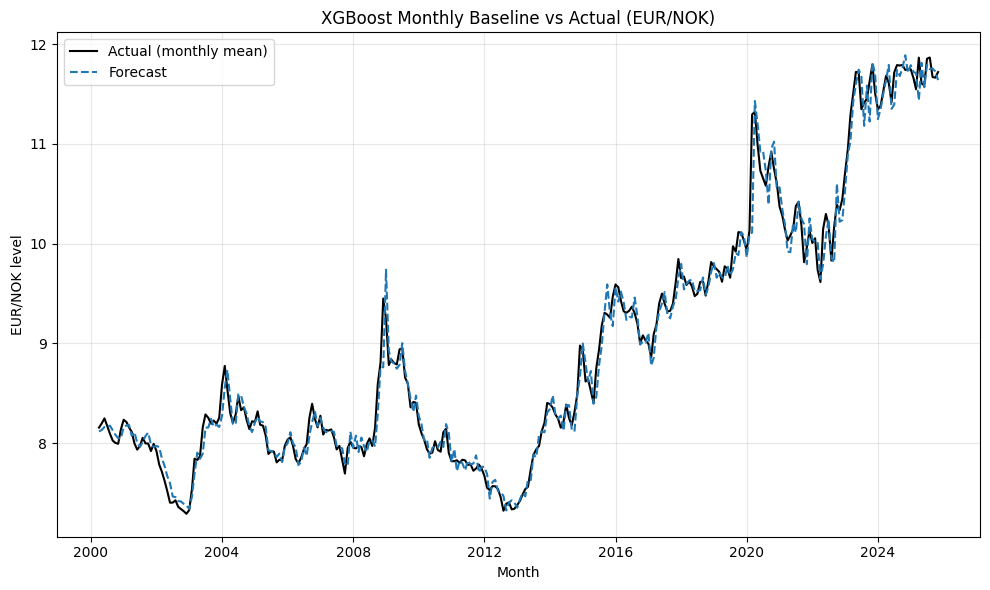

Saved: XGB_M_BASELINE.png

=== XGBoost Monthly – Recommended (VIX, Q, Brent) (monthly mean) ===
Observations: 308
RMSE (level): 0.154396
MAE  (level): 0.101191
Directional accuracy: 214/307 (69.7%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 1.6340
p-value     : 0.1023


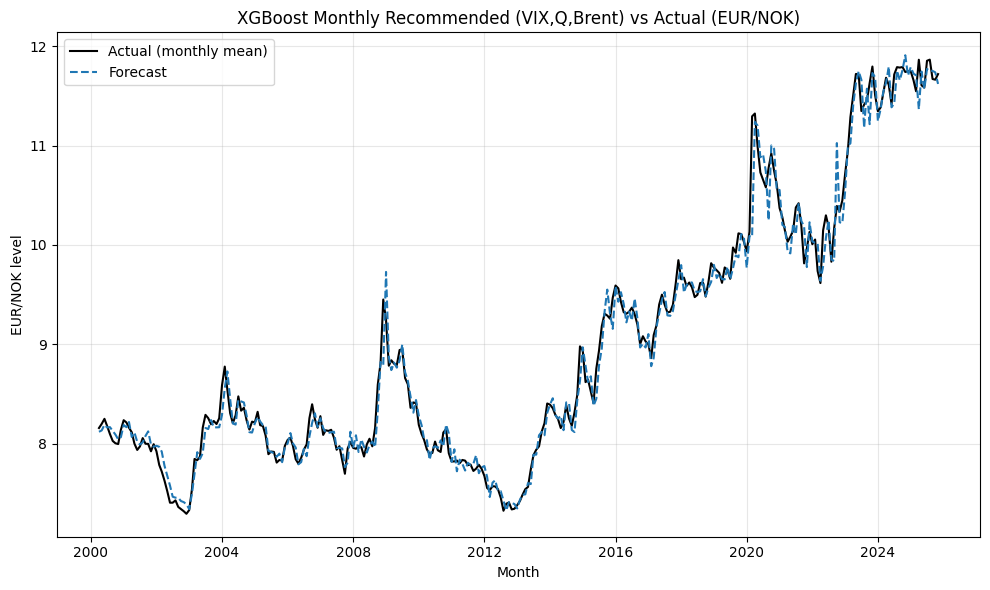

Saved: XGB_M_RECOMMENDED_VIX_Q_BRENT.png

=== Monthly comparison objects ===
res_base_m: {'label': 'XGBoost Monthly – Baseline (all covariates)', 'observations': 308, 'rmse': 0.14941111748129574, 'mae': 0.10031639989195974, 'dir_hits': 206, 'dir_total': 307, 'dir_acc': 0.6710097719869706, 'dm_stat': 1.3307643608856907, 'dm_pvalue': 0.18326655810307013, 'better_than_rw': False, 'sig': ''}
res_rec_m : {'label': 'XGBoost Monthly – Recommended (VIX, Q, Brent)', 'observations': 308, 'rmse': 0.1543960076690687, 'mae': 0.10119113057071048, 'dir_hits': 214, 'dir_total': 307, 'dir_acc': 0.6970684039087948, 'dm_stat': 1.633962472030421, 'dm_pvalue': 0.10226673075334292, 'better_than_rw': False, 'sig': ''}


In [26]:
# ============================
# ONE-CELL: XGBoost Monthly -> Baseline vs Recommended (based on your LOO)
# Recommended (Monthly): VIX, Q, Brent
# ============================

import warnings
from dataclasses import dataclass
from typing import Dict, List, Tuple
import numpy as np
import pandas as pd
from xgboost import XGBRegressor

warnings.filterwarnings("ignore", category=FutureWarning)

TARGET_SERIES = "EUR_NOK"
EXOG_COLS  = ["Brent", "VIX", "StoxEurope", "SP500", "OSEBX", "OBX_Energy"]
MACRO_COLS = ["Q", "d_pi", "dI_t"]
ALL_COV_COLS = EXOG_COLS + MACRO_COLS

REC_COV_COLS_M = ["VIX", "Q", "Brent"]   # <- monthly recommendation

BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,
}

@dataclass
class CFG_M:
    m_freq: str = "M"
    min_hist_days: int = 40
    max_lags: int = 20
    max_horizon: int = 64
    verbose: bool = True
    loss: str = "mse"
    h_dm: int = 1

CFG = CFG_M()

def _xgb_device_kwargs() -> Dict:
    try:
        import xgboost
        ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
        if ver >= (2, 0):
            return {"tree_method": "hist", "device": "cuda"}
        return {"tree_method": "gpu_hist"}
    except Exception:
        return {"tree_method": "hist"}

def make_lag_matrix(df_hist: pd.DataFrame, target: str, predictors: List[str], L: int) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[[target] + predictors].copy()
    lag_cols: List[str] = []
    for v in [target] + predictors:
        for k in range(1, L + 1):
            c = f"{v}_lag{k}"
            work[c] = work[v].shift(k)
            lag_cols.append(c)
    work = work.dropna()
    return work[lag_cols].to_numpy(), work[target].to_numpy()

def fit_xgb_one_step(df_hist_daily: pd.DataFrame, target: str, predictors: List[str]) -> XGBRegressor:
    X, y = make_lag_matrix(df_hist_daily, target=target, predictors=predictors, L=CFG.max_lags)
    if X.shape[0] < 30:
        raise ValueError("Too few obs after lagging for stable XGB fit.")

    p = dict(BEST_PARAMS)
    p["max_depth"] = int(round(p["max_depth"]))
    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=42,
        n_jobs=1,
        **_xgb_device_kwargs(),
        **p
    )
    model.fit(X, y)
    return model

def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, target: str, predictors: List[str], H: int) -> pd.Series:
    hist = df_hist_daily[[target] + predictors].copy()
    frozen = hist[predictors].iloc[-1].to_dict()
    preds: List[float] = []
    for _ in range(H):
        feat = []
        for v in [target] + predictors:
            lags = hist[v].iloc[-CFG.max_lags:][::-1].to_numpy()
            feat.extend(lags.tolist())
        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)
        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        hist = pd.concat([hist, pd.DataFrame([{target: yhat, **frozen}], index=[new_idx])])
    return pd.Series(preds)

def walk_forward_monthly_perioddf(S_b: pd.Series, S_d: pd.Series, COV_d: pd.DataFrame, cov_cols: List[str]) -> pd.DataFrame:
    first_m = pd.Period(S_b.index.min(), freq=CFG.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=CFG.m_freq)
    months = pd.period_range(first_m, last_m, freq=CFG.m_freq)

    rows = []
    for m in months:
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            continue

        hist_target_d = S_d.loc[:cut]
        if len(hist_target_d) < CFG.min_hist_days:
            continue

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            continue

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])

        start_fc = cut + pd.Timedelta(days=1)
        H = (m_end.normalize() - start_fc.normalize()).days + 1
        if H <= 0 or H > CFG.max_horizon:
            continue

        hist_df = pd.DataFrame({TARGET_SERIES: S_d}).join(COV_d[cov_cols], how="left").ffill()
        hist_df = hist_df.loc[:cut].dropna(subset=[TARGET_SERIES])

        try:
            model = fit_xgb_one_step(hist_df, target=TARGET_SERIES, predictors=cov_cols)
            pf = recursive_daily_forecast(model, hist_df, target=TARGET_SERIES, predictors=cov_cols, H=H)
            pred_daily = pd.Series(pf.values, index=pd.date_range(start_fc, periods=H, freq="D"))
            pred_b = pred_daily.reindex(idx_m_b)
            if pred_b.isna().all():
                continue
            y_pred = float(pred_b.dropna().mean())
            rows.append({"month": m, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level})
        except Exception:
            continue

    df = pd.DataFrame(rows)
    if df.empty:
        return df
    df = df.set_index("month").sort_index()
    if not isinstance(df.index, pd.PeriodIndex):
        df.index = pd.PeriodIndex(df.index, freq="M")
    return df

# -----------------------------
# RUN
# -----------------------------
S_b, S_d = load_fx_series_daily_and_business(
    url=DATA_CFG.url,
    series=TARGET_SERIES,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)
COV_all = load_daily_covariates(DATA_CFG.url, ALL_COV_COLS)

period_df_base_m = walk_forward_monthly_perioddf(S_b, S_d, COV_all, ALL_COV_COLS)
core_base_m, res_base_m = EVAL_MONTHLY["evaluate_period_df"](
    period_df_base_m, loss=CFG.loss, h=CFG.h_dm,
    label="XGBoost Monthly – Baseline (all covariates)",
    print_output=True,
)
EVAL_MONTHLY["plot_period_simple"](
    period_df_base_m,
    title="XGBoost Monthly Baseline vs Actual (EUR/NOK)",
    png_path="XGB_M_BASELINE.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

period_df_rec_m = walk_forward_monthly_perioddf(S_b, S_d, COV_all, REC_COV_COLS_M)
core_rec_m, res_rec_m = EVAL_MONTHLY["evaluate_period_df"](
    period_df_rec_m, loss=CFG.loss, h=CFG.h_dm,
    label="XGBoost Monthly – Recommended (VIX, Q, Brent)",
    print_output=True,
)
EVAL_MONTHLY["plot_period_simple"](
    period_df_rec_m,
    title="XGBoost Monthly Recommended (VIX,Q,Brent) vs Actual (EUR/NOK)",
    png_path="XGB_M_RECOMMENDED_VIX_Q_BRENT.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

print("\n=== Monthly comparison objects ===")
print("res_base_m:", res_base_m)
print("res_rec_m :", res_rec_m)


## Q

Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period

=== XGBoost (BEST_PARAMS) – past covariates (frozen in recursion) [Quarterly] (quarterly mean) ===
Observations: 103
RMSE (level): 0.206629
MAE  (level): 0.150391
Directional accuracy: 75/102 (73.5%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: -0.8990
p-value     : 0.3687


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-1218220960.py:85: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period

=== Robust LOO (locked quarters): rank by ΔDM-stat (higher = worse when removed) ===
 covariate  n_periods   dm_stat  dm_ci_lo  dm_ci_hi  delta_dm_vs_base    mean_d  mean_d_ci_lo  mean_d_ci_hi  delta_mean_d_vs_base
       VIX        103  1.062266 -1.131172  2.570749          1.961267  0.005523     -0.003118      0.017381              0.008063
         Q        103 -0.541080 -1.836192  1.435858          0.357920 -0.001734     -0.007071      0.003794              0.000807
     Brent        103 -0.719369 -1.982066  1.142472          0.179631 -0.002699     -0.009723      0.002772             -0.000159
OBX_Energy        103 -0.746332 -1.935711  1.099477          0.152668 -0.002169     -0.007305      0.002480              0.000371
      dI_t        103 -0.877486 -2.021978  0.901542          0.021514 -0.002483     -0.007140      0.001792              0.000057
      d_pi        103 -0.909738 -2.096678  1.000320         -0.010738 -

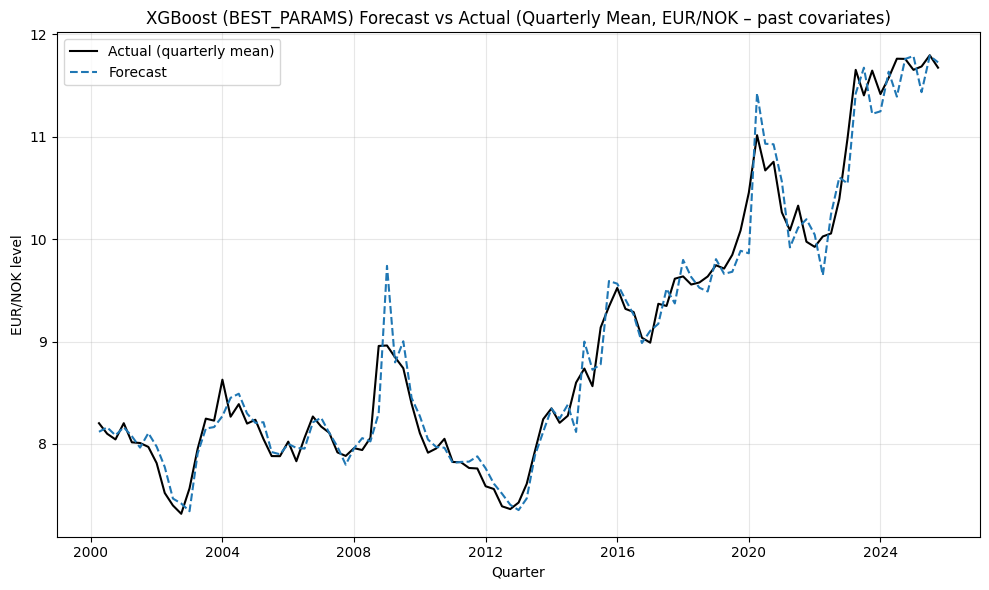

Saved: XGB_Q_LOO.png

DONE: core_xgb_q, res_xgb_q, loo_xgb_q, period_df_base_q are in memory.


In [24]:
# ============================
# ONE-CELL: XGBoost (BEST_PARAMS) -> Quarterly baseline -> Robust LOO (same as Chronos logic)
# Requires already in notebook:
#   - download_csv_text, DATA_CFG
#   - load_fx_series_daily_and_business, last_trading_day
#   - load_daily_covariates
#   - EVAL_QUARTERLY (evaluate_period_df + plot_period_simple)
# ============================

import warnings
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import numpy as np
import pandas as pd
from xgboost import XGBRegressor

warnings.filterwarnings("ignore", category=FutureWarning)

# -----------------------------
# Config
# -----------------------------
TARGET_SERIES = "EUR_NOK"
EXOG_COLS  = ["Brent", "VIX", "StoxEurope", "SP500", "OSEBX", "OBX_Energy"]
MACRO_COLS = ["Q", "d_pi", "dI_t"]
ALL_COV_COLS = EXOG_COLS + MACRO_COLS

# ---- INSERT YOUR TUNED XGB PARAMS HERE ----
BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,

}

@dataclass
class CFG_Q:
    q_freq: str = "Q-DEC"
    min_hist_days: int = 40
    max_lags: int = 20
    max_horizon: int = 128
    verbose: bool = True
    # robustness knobs
    loss: str = "mse"       # "mse" or "mae"
    h_dm: int = 1
    block_len: int = 8      # quarters per bootstrap block (analog to 12 months)
    n_boot: int = 500
    random_seed: int = 123

CFG = CFG_Q()

# -----------------------------
# XGB version-safe GPU kwargs (optional)
# -----------------------------
def _xgb_device_kwargs() -> Dict:
    try:
        import xgboost
        ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
        if ver >= (2, 0):
            return {"tree_method": "hist", "device": "cuda"}
        return {"tree_method": "gpu_hist"}
    except Exception:
        return {"tree_method": "hist"}  # CPU fallback

# -----------------------------
# Feature builder (lags of target + covariates)
# -----------------------------
def make_lag_matrix(
    df_hist: pd.DataFrame,
    target: str,
    predictors: List[str],
    L: int
) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[[target] + predictors].copy()
    lag_cols: List[str] = []

    for v in [target] + predictors:
        for k in range(1, L + 1):
            c = f"{v}_lag{k}"
            work[c] = work[v].shift(k)
            lag_cols.append(c)

    work = work.dropna()
    X = work[lag_cols].to_numpy()
    y = work[target].to_numpy()
    return X, y

def fit_xgb_one_step(df_hist_daily: pd.DataFrame, target: str, predictors: List[str]) -> XGBRegressor:
    X, y = make_lag_matrix(df_hist_daily, target=target, predictors=predictors, L=CFG.max_lags)
    if X.shape[0] < 30:
        raise ValueError("Too few obs after lagging for stable XGB fit.")

    p = dict(XGB_BEST_PARAMS)
    for k in ("n_estimators","max_depth"):
        if k in p:
            p[k] = int(round(p[k]))

    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=42,
        n_jobs=1,
        **_xgb_device_kwargs(),
        **p
    )
    model.fit(X, y)
    return model

def recursive_daily_forecast(
    model: XGBRegressor,
    df_hist_daily: pd.DataFrame,
    target: str,
    predictors: List[str],
    H: int
) -> pd.Series:
    """
    Anti-leakage recursion:
      - All predictors (covariates) frozen at last observed value
      - Only target updated with predictions
    """
    hist = df_hist_daily[[target] + predictors].copy()
    frozen = hist[predictors].iloc[-1].to_dict()
    preds: List[float] = []

    for _ in range(H):
        if len(hist) < CFG.max_lags:
            raise ValueError("Not enough history to form lag features.")

        feat = []
        for v in [target] + predictors:
            lags = hist[v].iloc[-CFG.max_lags:][::-1].to_numpy()
            feat.extend(lags.tolist())

        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)

        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        new_row = {target: yhat, **frozen}
        hist = pd.concat([hist, pd.DataFrame([new_row], index=[new_idx])])

    return pd.Series(preds)

# -----------------------------
# Walk-forward -> period_df (Quarterly)
# -----------------------------
def walk_forward_quarterly_perioddf(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: pd.DataFrame,
    cov_cols: List[str],
) -> pd.DataFrame:
    first_q = pd.Period(S_b.index.min(), freq=CFG.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=CFG.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=CFG.q_freq)

    rows: Dict[str, Dict[str, float]] = {}
    dropped: Dict[str, str] = {}

    for q in quarters:
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time
        prev_start, prev_end = prev_q.start_time, prev_q.end_time

        cut = last_trading_day(S_b, prev_start, prev_end)
        if cut is None:
            dropped[str(q)] = "no_cut_in_prev_period"
            continue

        hist_target_d = S_d.loc[:cut]
        if len(hist_target_d) < CFG.min_hist_days:
            dropped[str(q)] = f"hist<{CFG.min_hist_days}"
            continue

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            dropped[str(q)] = "no_bdays_in_quarter"
            continue

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])

        H = (q_end.date() - q_start.date()).days + 1
        if H <= 0 or H > CFG.max_horizon:
            dropped[str(q)] = f"horizon_invalid(H={H})"
            continue

        hist_df = pd.DataFrame({TARGET_SERIES: S_d}).join(COV_d[cov_cols], how="left").ffill()
        hist_df = hist_df.loc[:cut].copy()
        hist_df = hist_df.dropna(subset=[TARGET_SERIES])

        try:
            model = fit_xgb_one_step(hist_df, target=TARGET_SERIES, predictors=cov_cols)
            pf = recursive_daily_forecast(model, hist_df, target=TARGET_SERIES, predictors=cov_cols, H=H)

            f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
            pred_daily = pd.Series(pf.values, index=f_idx).ffill()

            pred_b = pred_daily.reindex(idx_q_b, method=None)
            if pred_b.isna().all():
                dropped[str(q)] = "no_overlap_pred_B_days"
                continue

            y_pred = float(pred_b.dropna().mean())
            rows[str(q)] = {"quarter": q, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level}

        except Exception as e:
            dropped[str(q)] = f"fit_or_forecast_failed: {type(e).__name__}"
            continue

    period_df = pd.DataFrame.from_dict(rows, orient="index")
    if not period_df.empty:
        period_df = period_df.set_index("quarter").sort_index()
        if not isinstance(period_df.index, pd.PeriodIndex):
            period_df.index = pd.PeriodIndex(period_df.index, freq=CFG.q_freq)

    if CFG.verbose:
        miss = [str(q) for q in quarters if (period_df.empty or q not in period_df.index)]
        if miss:
            print("\nDropped quarters and reasons:")
            for qq in miss:
                print(f"  {qq}: {dropped.get(qq, 'unknown')}")

    return period_df

# -----------------------------
# Robust LOO utilities (same logic as Chronos cell)
# -----------------------------
def _loss_vec(err: pd.Series, loss: str) -> pd.Series:
    loss = loss.lower()
    if loss == "mae":
        return err.abs()
    if loss == "mse":
        return err.pow(2)
    raise ValueError("loss must be 'mse' or 'mae'")

def compute_dm_components(period_df: pd.DataFrame, loss: str) -> pd.Series:
    df = period_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    if df.empty:
        return pd.Series(dtype=float)
    e_m = df["y_true"] - df["y_pred"]
    e_r = df["y_true"] - df["cut_level"].astype(float)
    d = _loss_vec(e_m, loss) - _loss_vec(e_r, loss)
    d.index = df.index
    return d

def dm_stat_from_d(d: pd.Series, h: int = 1) -> float:
    d = d.dropna()
    N = int(len(d))
    if N < 5:
        return float("nan")

    d_mean = float(d.mean())
    gamma0 = float(np.var(d, ddof=1)) if N > 1 else 0.0
    var_bar = gamma0 / N

    if h > 1 and N > 2:
        for k in range(1, min(h - 1, N - 1) + 1):
            w_k = 1.0 - k / h
            cov_k = float(np.cov(d[k:], d[:-k], ddof=1)[0, 1])
            var_bar += 2.0 * w_k * cov_k / N

    if var_bar <= 0 or not np.isfinite(var_bar):
        return float("nan")

    return float(d_mean / np.sqrt(var_bar))

def block_bootstrap_ci(
    d: pd.Series,
    block_len: int,
    n_boot: int,
    seed: int,
) -> Tuple[Tuple[float, float], Tuple[float, float]]:
    rng = np.random.default_rng(seed)
    d = d.dropna().astype(float)
    T = len(d)
    if T < 10:
        return (float("nan"), float("nan")), (float("nan"), float("nan"))

    x = d.to_numpy()
    max_start = max(1, T - block_len + 1)
    starts = np.arange(max_start)

    means = np.empty(n_boot, dtype=float)
    dmstats = np.empty(n_boot, dtype=float)

    for b in range(n_boot):
        sample = []
        while len(sample) < T:
            s = int(rng.choice(starts))
            sample.extend(x[s : s + block_len])
        sample = np.asarray(sample[:T], dtype=float)
        means[b] = float(np.mean(sample))
        dmstats[b] = dm_stat_from_d(pd.Series(sample), h=CFG.h_dm)

    ci_mean = (float(np.quantile(means, 0.025)), float(np.quantile(means, 0.975)))
    ci_dm   = (float(np.quantile(dmstats, 0.025)), float(np.quantile(dmstats, 0.975)))
    return ci_mean, ci_dm

def robust_leave_one_out(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: pd.DataFrame,
    cov_cols: List[str],
) -> Tuple[pd.DataFrame, pd.DataFrame]:
    base_df = walk_forward_quarterly_perioddf(S_b, S_d, COV_d, cov_cols)
    base_df = base_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    base_periods = base_df.index

    d_base = compute_dm_components(base_df, CFG.loss).reindex(base_periods).dropna()
    base_mean = float(d_base.mean()) if len(d_base) else float("nan")
    base_dm   = dm_stat_from_d(d_base, h=CFG.h_dm)
    ci_mean_base, ci_dm_base = block_bootstrap_ci(
        d_base, block_len=CFG.block_len, n_boot=CFG.n_boot, seed=CFG.random_seed
    )

    rows = [{
        "covariate": "__BASELINE__",
        "n_periods": int(len(d_base)),
        "mean_d": base_mean,
        "mean_d_ci_lo": ci_mean_base[0],
        "mean_d_ci_hi": ci_mean_base[1],
        "dm_stat": base_dm,
        "dm_ci_lo": ci_dm_base[0],
        "dm_ci_hi": ci_dm_base[1],
        "delta_mean_d_vs_base": 0.0,
        "delta_dm_vs_base": 0.0,
    }]

    for c in cov_cols:
        reduced = [x for x in cov_cols if x != c]
        df_i = walk_forward_quarterly_perioddf(S_b, S_d, COV_d, reduced)

        df_i = df_i.reindex(base_periods)
        df_i = df_i.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()

        d_i = compute_dm_components(df_i, CFG.loss).reindex(base_periods).dropna()

        mean_i = float(d_i.mean()) if len(d_i) else float("nan")
        dm_i = dm_stat_from_d(d_i, h=CFG.h_dm)
        ci_mean_i, ci_dm_i = block_bootstrap_ci(
            d_i,
            block_len=CFG.block_len,
            n_boot=CFG.n_boot,
            seed=CFG.random_seed + 1000 + (hash(c) % 100000),
        )

        rows.append({
            "covariate": c,
            "n_periods": int(len(d_i)),
            "mean_d": mean_i,
            "mean_d_ci_lo": ci_mean_i[0],
            "mean_d_ci_hi": ci_mean_i[1],
            "dm_stat": dm_i,
            "dm_ci_lo": ci_dm_i[0],
            "dm_ci_hi": ci_dm_i[1],
            "delta_mean_d_vs_base": (mean_i - base_mean) if np.isfinite(mean_i) and np.isfinite(base_mean) else np.nan,
            "delta_dm_vs_base": (dm_i - base_dm) if np.isfinite(dm_i) and np.isfinite(base_dm) else np.nan,
        })

    out = pd.DataFrame(rows).sort_values(["covariate"]).reset_index(drop=True)
    return out, base_df

def print_ranked_tables(robust_df: pd.DataFrame) -> None:
    base = robust_df.loc[robust_df["covariate"] == "__BASELINE__"].iloc[0]
    loo = robust_df[robust_df["covariate"] != "__BASELINE__"].copy()

    loo_dm = loo.sort_values("delta_dm_vs_base", ascending=False)
    print("\n=== Robust LOO (locked quarters): rank by ΔDM-stat (higher = worse when removed) ===")
    print(loo_dm[[
        "covariate","n_periods","dm_stat","dm_ci_lo","dm_ci_hi","delta_dm_vs_base",
        "mean_d","mean_d_ci_lo","mean_d_ci_hi","delta_mean_d_vs_base"
    ]].to_string(index=False))

    loo_md = loo.sort_values("delta_mean_d_vs_base", ascending=False)
    print("\n=== Robust LOO (locked quarters): rank by Δmean(d) (higher = worse when removed) ===")
    print(loo_md[[
        "covariate","n_periods","mean_d","mean_d_ci_lo","mean_d_ci_hi","delta_mean_d_vs_base",
        "dm_stat","dm_ci_lo","dm_ci_hi","delta_dm_vs_base"
    ]].to_string(index=False))

    print("\n=== Baseline summary ===")
    print(
        f"n_periods={int(base['n_periods'])} | "
        f"mean(d)={base['mean_d']:.6g} [{base['mean_d_ci_lo']:.6g},{base['mean_d_ci_hi']:.6g}] | "
        f"DM={base['dm_stat']:.4f} [{base['dm_ci_lo']:.4f},{base['dm_ci_hi']:.4f}]"
    )

# ============================
# RUN (XGB Quarterly)
# ============================

# 1) Load target + covariates (your existing loaders)
S_b, S_d = load_fx_series_daily_and_business(
    url=DATA_CFG.url,
    series=TARGET_SERIES,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)
COV_d = load_daily_covariates(DATA_CFG.url, ALL_COV_COLS)

# 2) Baseline period_df
period_df_base_q = walk_forward_quarterly_perioddf(S_b, S_d, COV_d, ALL_COV_COLS)

# 3) Evaluate (your existing eval cell)
core_xgb_q, res_xgb_q = EVAL_QUARTERLY["evaluate_period_df"](
    period_df_base_q,
    loss=CFG.loss,
    h=CFG.h_dm,
    label="XGBoost (BEST_PARAMS) – past covariates (frozen in recursion) [Quarterly]",
    print_output=True,
)

# 4) Robust LOO
loo_xgb_q, _ = robust_leave_one_out(S_b, S_d, COV_d, ALL_COV_COLS)
print_ranked_tables(loo_xgb_q)

# 5) Plot (optional)
EVAL_QUARTERLY["plot_period_simple"](
    period_df_base_q,
    title="XGBoost (BEST_PARAMS) Forecast vs Actual (Quarterly Mean, EUR/NOK – past covariates)",
    png_path="XGB_Q_LOO.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

print("\nDONE: core_xgb_q, res_xgb_q, loo_xgb_q, period_df_base_q are in memory.")


Streaming output truncated to the last 5000 lines.
/tmp/ipython-input-2603156329.py:62: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-2603156329.py:62: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  work[c] = work[v].shift(k)
/tmp/ipython-input-2603156329.py:62: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a 


=== XGBoost Quarterly – Baseline (all covariates) (quarterly mean) ===
Observations: 103
RMSE (level): 0.206628
MAE  (level): 0.150391
Directional accuracy: 75/102 (73.5%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: -0.8990
p-value     : 0.3686


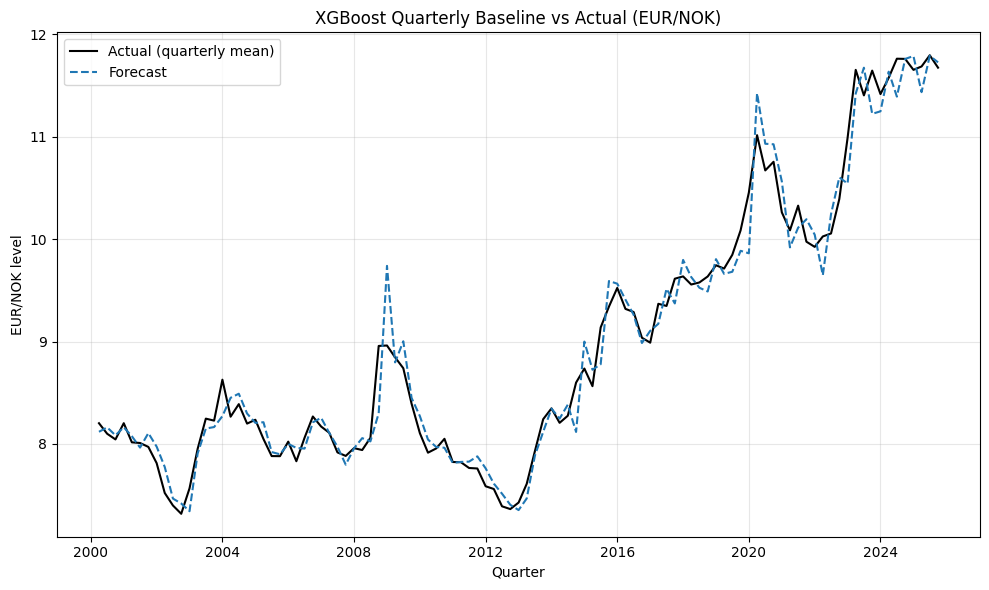

Saved: XGB_Q_BASELINE.png

=== XGBoost Quarterly – Recommended A (VIX only) (quarterly mean) ===
Observations: 103
RMSE (level): 0.210569
MAE  (level): 0.154640
Directional accuracy: 72/102 (70.6%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: -0.2279
p-value     : 0.8198


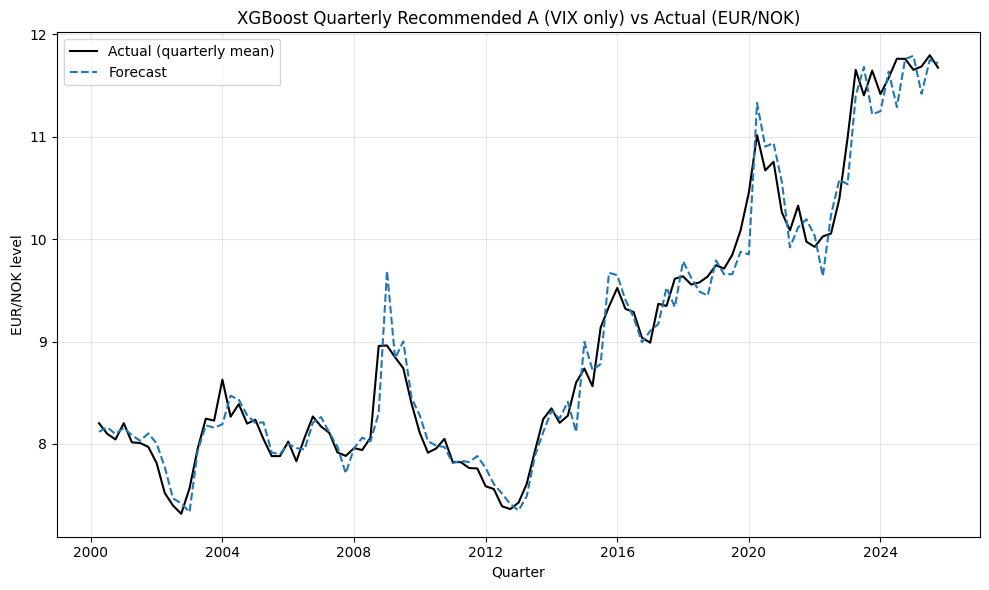

Saved: XGB_Q_REC_VIX_ONLY.png

=== XGBoost Quarterly – Recommended B (VIX, Q, Brent) (quarterly mean) ===
Observations: 103
RMSE (level): 0.214673
MAE  (level): 0.154378
Directional accuracy: 75/102 (73.5%)

=== Diebold–Mariano vs Random Walk (cut-level RW) ===
Loss: MSE | horizon h=1
DM-statistic: 0.1658
p-value     : 0.8683


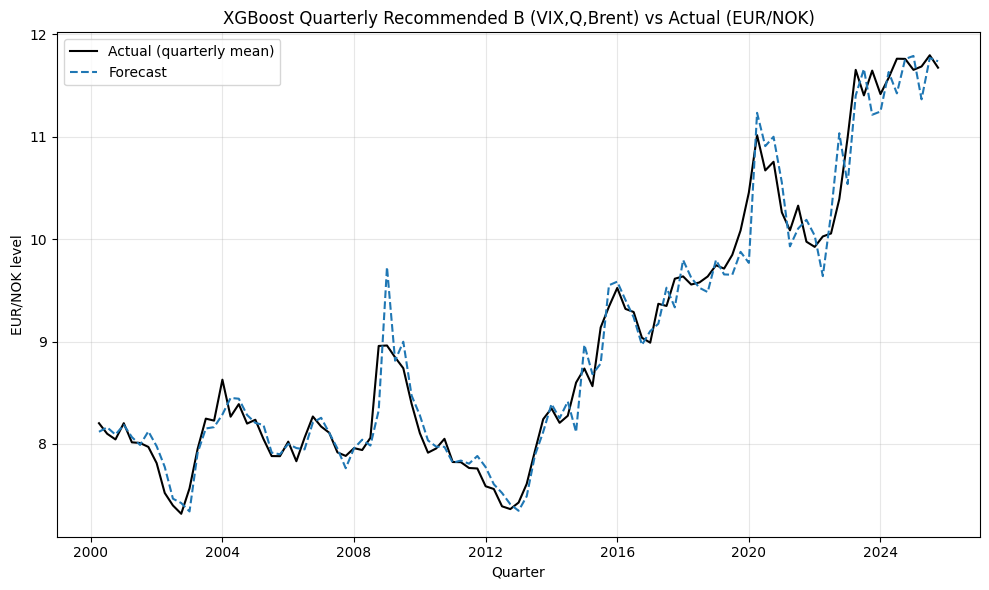

Saved: XGB_Q_REC_VIX_Q_BRENT.png

=== Quarterly comparison objects ===
res_base_q : {'label': 'XGBoost Quarterly – Baseline (all covariates)', 'observations': 103, 'rmse': 0.2066284814353579, 'mae': 0.15039111524284646, 'dir_hits': 75, 'dir_total': 102, 'dir_acc': 0.7352941176470589, 'dm_stat': -0.899029391798858, 'dm_pvalue': 0.3686370053358803, 'better_than_rw': True, 'sig': ''}
res_rec_qA : {'label': 'XGBoost Quarterly – Recommended A (VIX only)', 'observations': 103, 'rmse': 0.21056858294178832, 'mae': 0.15463958775764028, 'dir_hits': 72, 'dir_total': 102, 'dir_acc': 0.7058823529411765, 'dm_stat': -0.22785723799404706, 'dm_pvalue': 0.81975722738778, 'better_than_rw': True, 'sig': ''}
res_rec_qB : {'label': 'XGBoost Quarterly – Recommended B (VIX, Q, Brent)', 'observations': 103, 'rmse': 0.21467349207477165, 'mae': 0.1543777740666804, 'dir_hits': 75, 'dir_total': 102, 'dir_acc': 0.7352941176470589, 'dm_stat': 0.16583217113376553, 'dm_pvalue': 0.8682890277393029, 'better_than_rw': Fa

In [27]:
# ============================
# ONE-CELL: XGBoost Quarterly -> Baseline vs Recommended (based on your LOO)
# Recommended (Quarterly): VIX (strong); optionally add Q and Brent
# ============================

import warnings
from dataclasses import dataclass
from typing import Dict, List, Tuple
import numpy as np
import pandas as pd
from xgboost import XGBRegressor

warnings.filterwarnings("ignore", category=FutureWarning)

TARGET_SERIES = "EUR_NOK"
EXOG_COLS  = ["Brent", "VIX", "StoxEurope", "SP500", "OSEBX", "OBX_Energy"]
MACRO_COLS = ["Q", "d_pi", "dI_t"]
ALL_COV_COLS = EXOG_COLS + MACRO_COLS

REC_COV_COLS_Q_A = ["VIX"]                 # <- quarterly: strongest signal
REC_COV_COLS_Q_B = ["VIX", "Q", "Brent"]   # <- optional alternative

BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,
}

@dataclass
class CFG_Q:
    q_freq: str = "Q-DEC"
    min_hist_days: int = 40
    max_lags: int = 20
    max_horizon: int = 128
    verbose: bool = True
    loss: str = "mse"
    h_dm: int = 1

CFG = CFG_Q()

def _xgb_device_kwargs() -> Dict:
    try:
        import xgboost
        ver = tuple(int(x) for x in xgboost.__version__.split(".")[:2])
        if ver >= (2, 0):
            return {"tree_method": "hist", "device": "cuda"}
        return {"tree_method": "gpu_hist"}
    except Exception:
        return {"tree_method": "hist"}

def make_lag_matrix(df_hist: pd.DataFrame, target: str, predictors: List[str], L: int) -> Tuple[np.ndarray, np.ndarray]:
    work = df_hist[[target] + predictors].copy()
    lag_cols: List[str] = []
    for v in [target] + predictors:
        for k in range(1, L + 1):
            c = f"{v}_lag{k}"
            work[c] = work[v].shift(k)
            lag_cols.append(c)
    work = work.dropna()
    return work[lag_cols].to_numpy(), work[target].to_numpy()

def fit_xgb_one_step(df_hist_daily: pd.DataFrame, target: str, predictors: List[str]) -> XGBRegressor:
    X, y = make_lag_matrix(df_hist_daily, target=target, predictors=predictors, L=CFG.max_lags)
    if X.shape[0] < 30:
        raise ValueError("Too few obs after lagging for stable XGB fit.")
    p = dict(BEST_PARAMS)
    p["max_depth"] = int(round(p["max_depth"]))
    model = XGBRegressor(
        objective="reg:squarederror",
        eval_metric="rmse",
        random_state=42,
        n_jobs=1,
        **_xgb_device_kwargs(),
        **p
    )
    model.fit(X, y)
    return model

def recursive_daily_forecast(model: XGBRegressor, df_hist_daily: pd.DataFrame, target: str, predictors: List[str], H: int) -> pd.Series:
    hist = df_hist_daily[[target] + predictors].copy()
    frozen = hist[predictors].iloc[-1].to_dict()
    preds: List[float] = []
    for _ in range(H):
        feat = []
        for v in [target] + predictors:
            lags = hist[v].iloc[-CFG.max_lags:][::-1].to_numpy()
            feat.extend(lags.tolist())
        yhat = float(model.predict(np.asarray(feat, dtype=float).reshape(1, -1))[0])
        preds.append(yhat)
        new_idx = hist.index[-1] + pd.Timedelta(days=1)
        hist = pd.concat([hist, pd.DataFrame([{target: yhat, **frozen}], index=[new_idx])])
    return pd.Series(preds)

def walk_forward_quarterly_perioddf(S_b: pd.Series, S_d: pd.Series, COV_d: pd.DataFrame, cov_cols: List[str]) -> pd.DataFrame:
    first_q = pd.Period(S_b.index.min(), freq=CFG.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=CFG.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=CFG.q_freq)

    rows = []
    for q in quarters:
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time

        cut = last_trading_day(S_b, prev_q.start_time, prev_q.end_time)
        if cut is None:
            continue

        hist_target_d = S_d.loc[:cut]
        if len(hist_target_d) < CFG.min_hist_days:
            continue

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            continue

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])

        start_fc = cut + pd.Timedelta(days=1)
        H = (q_end.normalize() - start_fc.normalize()).days + 1
        if H <= 0 or H > CFG.max_horizon:
            continue

        hist_df = pd.DataFrame({TARGET_SERIES: S_d}).join(COV_d[cov_cols], how="left").ffill()
        hist_df = hist_df.loc[:cut].dropna(subset=[TARGET_SERIES])

        try:
            model = fit_xgb_one_step(hist_df, target=TARGET_SERIES, predictors=cov_cols)
            pf = recursive_daily_forecast(model, hist_df, target=TARGET_SERIES, predictors=cov_cols, H=H)
            pred_daily = pd.Series(pf.values, index=pd.date_range(start_fc, periods=H, freq="D"))
            pred_b = pred_daily.reindex(idx_q_b)
            if pred_b.isna().all():
                continue
            y_pred = float(pred_b.dropna().mean())
            rows.append({"quarter": q, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level})
        except Exception:
            continue

    df = pd.DataFrame(rows)
    if df.empty:
        return df
    df = df.set_index("quarter").sort_index()
    if not isinstance(df.index, pd.PeriodIndex):
        df.index = pd.PeriodIndex(df.index, freq=CFG.q_freq)
    return df

# -----------------------------
# RUN
# -----------------------------
S_b, S_d = load_fx_series_daily_and_business(
    url=DATA_CFG.url,
    series=TARGET_SERIES,
    retries=DATA_CFG.retries,
    timeout=DATA_CFG.timeout,
)
COV_all = load_daily_covariates(DATA_CFG.url, ALL_COV_COLS)

# Baseline
period_df_base_q = walk_forward_quarterly_perioddf(S_b, S_d, COV_all, ALL_COV_COLS)
core_base_q, res_base_q = EVAL_QUARTERLY["evaluate_period_df"](
    period_df_base_q, loss=CFG.loss, h=CFG.h_dm,
    label="XGBoost Quarterly – Baseline (all covariates)",
    print_output=True,
)
EVAL_QUARTERLY["plot_period_simple"](
    period_df_base_q,
    title="XGBoost Quarterly Baseline vs Actual (EUR/NOK)",
    png_path="XGB_Q_BASELINE.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

# Recommended A: VIX only
period_df_rec_qA = walk_forward_quarterly_perioddf(S_b, S_d, COV_all, REC_COV_COLS_Q_A)
core_rec_qA, res_rec_qA = EVAL_QUARTERLY["evaluate_period_df"](
    period_df_rec_qA, loss=CFG.loss, h=CFG.h_dm,
    label="XGBoost Quarterly – Recommended A (VIX only)",
    print_output=True,
)
EVAL_QUARTERLY["plot_period_simple"](
    period_df_rec_qA,
    title="XGBoost Quarterly Recommended A (VIX only) vs Actual (EUR/NOK)",
    png_path="XGB_Q_REC_VIX_ONLY.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

# Recommended B: VIX + Q + Brent (optional)
period_df_rec_qB = walk_forward_quarterly_perioddf(S_b, S_d, COV_all, REC_COV_COLS_Q_B)
core_rec_qB, res_rec_qB = EVAL_QUARTERLY["evaluate_period_df"](
    period_df_rec_qB, loss=CFG.loss, h=CFG.h_dm,
    label="XGBoost Quarterly – Recommended B (VIX, Q, Brent)",
    print_output=True,
)
EVAL_QUARTERLY["plot_period_simple"](
    period_df_rec_qB,
    title="XGBoost Quarterly Recommended B (VIX,Q,Brent) vs Actual (EUR/NOK)",
    png_path="XGB_Q_REC_VIX_Q_BRENT.png",
    pdf_path=None,
    y_label="EUR/NOK level",
    show=True,
)

print("\n=== Quarterly comparison objects ===")
print("res_base_q :", res_base_q)
print("res_rec_qA :", res_rec_qA)
print("res_rec_qB :", res_rec_qB)


# Robustness


Dropped months and reasons:
  2000-01: no_cut_in_prev_period
  2000-02: hist<200
  2000-03: hist<200
  2000-04: hist<200
  2000-05: hist<200
  2000-06: hist<200
  2000-07: hist<200
  2000-08: hist<200
  2000-09: supervised_too_small

Dropped quarters and reasons:
  2000Q1: no_cut_in_prev_period
  2000Q2: hist<200
  2000Q3: hist<200

=== MONTHLY (XGBoost) ===
                        Model  Obs     RMSE      MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)  302 0.158897 0.107841 0.654485  2.215315 0.026738   302

=== QUARTERLY (XGBoost) ===
                              Model  Obs     RMSE      MAE  DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Quarterly, macro+fin.exog)  101 0.207421 0.147489    0.74 -0.855451 0.392302   101


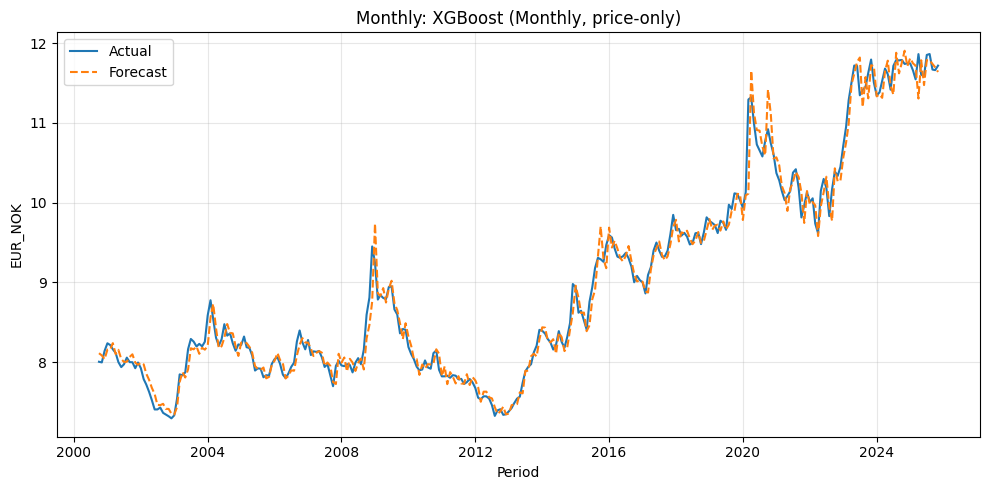

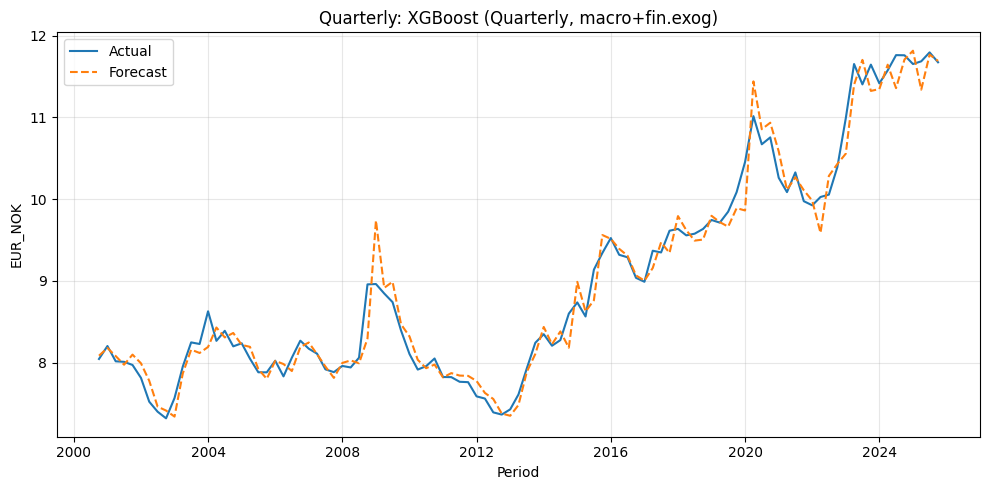


=== REGIME TABLES (MONTHLY) ===

--- Full sample ---
                        Model  Obs     RMSE      MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)  302 0.158897 0.107841 0.654485  2.215315 0.026738   302

--- Pre-GFC ---
                        Model  Obs     RMSE      MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)   86 0.107214 0.084085 0.623529  3.095009 0.001968    86

--- GFC+ ---
                        Model  Obs     RMSE     MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)  143 0.134894 0.09355 0.683099  1.194709 0.232201   143

--- COVID+ ---
                        Model  Obs     RMSE      MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)   23 0.321529 0.219898 0.681818  1.294667 0.195435    23

--- Energy+FX shock ---
                        Model  Obs     RMSE      MAE   DirAcc  DM_vs_RW  p_vs_RW  DM_n
XGBoost (Monthly, price-only)   47 0.186961 0.143045 0.565217   0.31108  0.75574    47

=== R

In [36]:
# ============================================================
# XGBoost ROBUSTNESS —
# - Monthly: price-only (best XGB monthly in your logs)
# - Quarterly: all covariates (macro+fin.exog, best XGB quarterly in your logs)
# - Regimes + pairwise DM + NULL-centered block bootstrap (DM vs RW)
#
# Requires already in notebook:
#   - download_csv_text, DATA_CFG
#   - load_fx_series_daily_and_business, last_trading_day
#   - load_daily_covariates
# ============================================================

from __future__ import annotations
import math, warnings
from dataclasses import dataclass
from typing import Dict, List, Tuple, Optional

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from xgboost import XGBRegressor

warnings.filterwarnings("ignore", category=FutureWarning)

# -----------------------------
# CONFIG
# -----------------------------
TARGET_SERIES = "EUR_NOK"

EXOG_COLS  = ["Brent", "VIX", "StoxEurope", "SP500", "OSEBX", "OBX_Energy"]
MACRO_COLS = ["Q", "d_pi", "dI_t"]
ALL_COV_COLS = EXOG_COLS + MACRO_COLS

# Best sets (based on your results)
XGB_MONTHLY_COLS   = [TARGET_SERIES]             # price-only
XGB_QUARTERLY_COLS = [TARGET_SERIES] + ALL_COV_COLS  # macro+fin.exog (all covariates)

XGB_BEST_PARAMS: Dict = {
    "learning_rate": 0.18340116810385773,
    "max_depth": 2,
    "min_child_weight": 6.1492880722622605,
    "subsample": 0.6458206971934747,
    "colsample_bytree": 0.9539153800516436,
    "gamma": 0.10081176035347532,
    "reg_alpha": 0.1186847530900767,
    "reg_lambda": 0.47901702155983267,
}

@dataclass
class CFG:
    m_freq: str = "M"
    q_freq: str = "Q-DEC"
    # feature construction
    n_lags: int = 32                 # use 32 daily lags for supervised features
    min_hist_days: int = 200         # need enough history for lags
    # horizons (daily predictions aggregated to period mean)
    max_horizon_m: int = 64
    max_horizon_q: int = 128
    # DM
    h_dm: int = 1
    # bootstrap
    bootstrap_B: int = 800
    bootstrap_block: Optional[int] = None  # None -> auto ~ n^(1/3)
    seed: int = 42
    show_plots: bool = True

C = CFG()

# -----------------------------
# REGIMES
# -----------------------------
@dataclass(frozen=True)
class Regime:
    name: str
    start: str
    end: str

REGIMES = [
    Regime("Full sample", "1900-01-01", "2100-01-01"),
    Regime("Pre-GFC", "2000-01-01", "2007-12-31"),
    Regime("GFC+", "2008-01-01", "2019-12-31"),
    Regime("COVID+", "2020-01-01", "2021-12-31"),
    Regime("Energy+FX shock", "2022-01-01", "2100-01-01"),
]

def filter_eval_by_regime(df_eval: pd.DataFrame, reg: Regime) -> pd.DataFrame:
    ts = df_eval.index.to_timestamp(how="end") if isinstance(df_eval.index, pd.PeriodIndex) else pd.to_datetime(df_eval.index)
    mask = (ts >= pd.Timestamp(reg.start)) & (ts <= pd.Timestamp(reg.end))
    return df_eval.loc[mask]

# -----------------------------
# METRICS + DM + BOOTSTRAP
# -----------------------------
def _normal_cdf(z: float) -> float:
    return 0.5 * (1.0 + math.erf(z / math.sqrt(2.0)))

def eval_metrics(period_df: pd.DataFrame) -> Dict[str, float]:
    core = period_df.dropna(subset=["y_true", "y_pred"]).copy()
    n = int(len(core))
    if n == 0:
        return dict(obs=0, rmse=np.nan, mae=np.nan, diracc=np.nan)

    err = core["y_true"] - core["y_pred"]
    rmse = float(np.sqrt(np.mean(err**2)))
    mae  = float(np.mean(np.abs(err)))

    core["y_prev"] = core["y_true"].shift(1)
    mask = core["y_prev"].notna()
    if mask.any():
        dir_true = np.sign(core.loc[mask, "y_true"] - core.loc[mask, "y_prev"])
        dir_pred = np.sign(core.loc[mask, "y_pred"] - core.loc[mask, "y_prev"])
        diracc = float((dir_true.values == dir_pred.values).mean())
    else:
        diracc = np.nan

    return dict(obs=n, rmse=rmse, mae=mae, diracc=diracc)

def _dm_from_d(d: np.ndarray) -> float:
    d = np.asarray(d, dtype=float)
    n = d.size
    if n < 10:
        return float("nan")
    sd = float(d.std(ddof=1))
    if not np.isfinite(sd) or sd <= 0:
        return float("nan")
    return float(d.mean() / (sd / math.sqrt(n)))

def dm_vs_rw_cutlevel(period_df: pd.DataFrame) -> Tuple[float, float, int]:
    core = period_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    if len(core) < 10:
        return float("nan"), float("nan"), int(len(core))

    e_m = core["y_true"].to_numpy() - core["y_pred"].to_numpy()
    e_r = core["y_true"].to_numpy() - core["cut_level"].to_numpy()
    d = (e_m**2) - (e_r**2)

    dm = _dm_from_d(d)
    p  = float(2.0 * (1.0 - _normal_cdf(abs(dm)))) if np.isfinite(dm) else float("nan")
    return float(dm), float(p), int(len(d))

def dm_pairwise(df_a: pd.DataFrame, df_b: pd.DataFrame) -> Tuple[float, float, int]:
    df = pd.concat({"y": df_a["y_true"], "a": df_a["y_pred"], "b": df_b["y_pred"]}, axis=1).dropna()
    if len(df) < 10:
        return float("nan"), float("nan"), int(len(df))
    e_a = df["y"].to_numpy() - df["a"].to_numpy()
    e_b = df["y"].to_numpy() - df["b"].to_numpy()
    d = (e_a**2) - (e_b**2)
    dm = _dm_from_d(d)
    p  = float(2.0 * (1.0 - _normal_cdf(abs(dm)))) if np.isfinite(dm) else float("nan")
    return float(dm), float(p), int(len(d))

def block_bootstrap_dm_vs_rw_null_centered(
    period_df: pd.DataFrame,
    B: int,
    block: Optional[int],
    seed: int = 42,
    one_sided: bool = True,
) -> Dict[str, float]:
    core = period_df.dropna(subset=["y_true", "y_pred", "cut_level"]).copy()
    n = int(len(core))
    if n < 30:
        return {"n": n, "dm_hat": np.nan, "p_boot": np.nan, "block": np.nan}

    e_m = core["y_true"].to_numpy() - core["y_pred"].to_numpy()
    e_r = core["y_true"].to_numpy() - core["cut_level"].to_numpy()
    d = (e_m**2) - (e_r**2)

    dm_hat = _dm_from_d(d)
    if not np.isfinite(dm_hat):
        return {"n": n, "dm_hat": float("nan"), "p_boot": float("nan"), "block": float("nan")}

    d0 = d - d.mean()

    if block is None:
        b = int(round(n ** (1/3)))
        b = max(5, min(b, max(5, n // 2)))
    else:
        b = int(block)
        b = max(2, min(b, max(2, n // 2)))

    rng = np.random.default_rng(seed)
    starts = np.arange(0, n - b + 1)
    if starts.size == 0:
        return {"n": n, "dm_hat": float(dm_hat), "p_boot": np.nan, "block": float(b)}

    dm_boot = np.empty(B, dtype=float)
    dm_boot[:] = np.nan

    for i in range(B):
        idx = []
        while len(idx) < n:
            s = int(rng.choice(starts))
            idx.extend(range(s, s + b))
        idx = idx[:n]
        d_s = d0[np.array(idx, dtype=int)]
        dm_boot[i] = _dm_from_d(d_s)

    dm_boot = dm_boot[np.isfinite(dm_boot)]
    if dm_boot.size < 50:
        return {"n": n, "dm_hat": float(dm_hat), "p_boot": np.nan, "block": float(b)}

    if one_sided:
        # convention: DM < 0 => model better than RW
        if dm_hat < 0:
            p_boot = float(np.mean(dm_boot <= dm_hat))
        else:
            p_boot = float(np.mean(dm_boot >= dm_hat))
    else:
        p_boot = float(np.mean(np.abs(dm_boot) >= abs(dm_hat)))

    return {"n": n, "dm_hat": float(dm_hat), "p_boot": float(p_boot), "block": float(b)}

# -----------------------------
# FEATURE BUILDING (daily -> supervised)
# -----------------------------
def make_supervised_matrix(
    y_d: pd.Series,
    cov_d: Optional[pd.DataFrame],
    feature_cols: List[str],
    n_lags: int,
) -> pd.DataFrame:
    """
    Builds a daily supervised dataset with lags 1..n_lags for the chosen columns.
    feature_cols includes TARGET_SERIES and optionally covariates.
    Output columns: y (target at t), X_* (lagged features)
    """
    df = pd.DataFrame(index=y_d.index)
    df[TARGET_SERIES] = y_d.astype(float)

    if cov_d is not None and len(feature_cols) > 1:
        use_cov = [c for c in feature_cols if c != TARGET_SERIES]
        tmp = cov_d[use_cov].reindex(df.index)
        # local alignment for model matrix; handling of missing should be described in methodology
        tmp = tmp.ffill()
        for c in use_cov:
            df[c] = pd.to_numeric(tmp[c], errors="coerce")

    # Lag features
    X = {}
    for c in feature_cols:
        for L in range(1, n_lags + 1):
            X[f"{c}_L{L}"] = df[c].shift(L)

    out = pd.DataFrame(X, index=df.index)
    out["y"] = df[TARGET_SERIES]
    out = out.dropna()
    return out

def fit_xgb(X: pd.DataFrame, y: pd.Series) -> XGBRegressor:
    m = XGBRegressor(
        n_estimators=1200,
        objective="reg:squarederror",
        random_state=C.seed,
        n_jobs=-1,
        **XGB_BEST_PARAMS,
    )
    m.fit(X, y)
    return m

# -----------------------------
# WALK-FORWARD: predict daily path then aggregate to period mean
# -----------------------------
def _predict_recursive(
    model: XGBRegressor,
    last_row_feats: pd.Series,
    horizon_days: int,
    feature_names: List[str],
    feature_cols: List[str],
    n_lags: int,
) -> pd.Series:
    """
    Recursive forecast for TARGET_SERIES only.
    Covariates are treated as "known up to cut" only; beyond cut they are held fixed at last observed levels
    via the lag structure. This matches a strict information set.
    """
    # We maintain a rolling buffer for each base column (TARGET and covs) as last n_lags values.
    base = {c: [] for c in feature_cols}
    # recover buffers from last_row_feats
    for c in feature_cols:
        buf = []
        for L in range(n_lags, 0, -1):
            buf.append(float(last_row_feats[f"{c}_L{L}"]))
        base[c] = buf  # oldest..newest (length n_lags)

    preds = []
    for _ in range(horizon_days):
        x_vec = {}
        for c in feature_cols:
            # create lag features from current buffer
            for L in range(1, n_lags + 1):
                x_vec[f"{c}_L{L}"] = base[c][-L]
        Xh = pd.DataFrame([x_vec], columns=feature_names)
        yhat = float(model.predict(Xh)[0])
        preds.append(yhat)

        # update TARGET buffer with prediction
        base[TARGET_SERIES] = base[TARGET_SERIES][1:] + [yhat]
        # covariates remain unchanged without future info; keep last value rolling
        for c in feature_cols:
            if c == TARGET_SERIES:
                continue
            base[c] = base[c][1:] + [base[c][-1]]

    return pd.Series(preds)

def walk_forward_monthly_xgb(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: Optional[pd.DataFrame],
    feature_cols: List[str],
) -> pd.DataFrame:
    first_m = pd.Period(S_b.index.min(), freq=C.m_freq)
    last_m  = pd.Period(S_b.index.max(), freq=C.m_freq)
    months = pd.period_range(first_m, last_m, freq=C.m_freq)

    rows, dropped = {}, {}

    for m in months:
        prev_m = m - 1
        m_start, m_end = m.start_time, m.end_time

        cut = last_trading_day(S_b, prev_m.start_time, prev_m.end_time)
        if cut is None:
            dropped[str(m)] = "no_cut_in_prev_period"
            continue

        hist_y = S_d.loc[:cut]
        if len(hist_y) < C.min_hist_days:
            dropped[str(m)] = f"hist<{C.min_hist_days}"
            continue

        idx_m_b = S_b.index[(S_b.index >= m_start) & (S_b.index <= m_end)]
        if idx_m_b.size < 1:
            dropped[str(m)] = "no_bdays_in_month"
            continue

        y_true = float(S_b.loc[idx_m_b].mean())
        cut_level = float(S_b.loc[cut])

        H = int((m_end.date() - m_start.date()).days + 1)
        if H <= 0 or H > C.max_horizon_m:
            dropped[str(m)] = f"horizon_invalid(H={H})"
            continue

        sup = make_supervised_matrix(hist_y, COV_d.loc[:cut] if COV_d is not None else None, feature_cols, C.n_lags)
        if len(sup) < 200:
            dropped[str(m)] = "supervised_too_small"
            continue

        X = sup.drop(columns=["y"])
        y = sup["y"]
        model = fit_xgb(X, y)

        last_row = X.iloc[-1]
        preds_d = _predict_recursive(model, last_row, H, X.columns.tolist(), feature_cols, C.n_lags)

        f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
        preds_d.index = f_idx

        # aggregate to business days in target period
        pred_b = preds_d.reindex(idx_m_b, method=None).ffill()
        if pred_b.isna().all():
            dropped[str(m)] = "no_overlap_pred_B_days"
            continue

        y_pred = float(pred_b.dropna().mean())
        rows[str(m)] = {"month": m, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level}

    df = pd.DataFrame.from_dict(rows, orient="index")
    if not df.empty:
        df = df.set_index("month").sort_index()
        df.index = pd.PeriodIndex(df.index, freq=C.m_freq)

    if dropped:
        print("\nDropped months and reasons:")
        for k, v in dropped.items():
            print(f"  {k}: {v}")
    return df

def walk_forward_quarterly_xgb(
    S_b: pd.Series,
    S_d: pd.Series,
    COV_d: Optional[pd.DataFrame],
    feature_cols: List[str],
) -> pd.DataFrame:
    first_q = pd.Period(S_b.index.min(), freq=C.q_freq)
    last_q  = pd.Period(S_b.index.max(), freq=C.q_freq)
    quarters = pd.period_range(first_q, last_q, freq=C.q_freq)

    rows, dropped = {}, {}

    for q in quarters:
        prev_q = q - 1
        q_start, q_end = q.start_time, q.end_time

        cut = last_trading_day(S_b, prev_q.start_time, prev_q.end_time)
        if cut is None:
            dropped[str(q)] = "no_cut_in_prev_period"
            continue

        hist_y = S_d.loc[:cut]
        if len(hist_y) < C.min_hist_days:
            dropped[str(q)] = f"hist<{C.min_hist_days}"
            continue

        idx_q_b = S_b.index[(S_b.index >= q_start) & (S_b.index <= q_end)]
        if idx_q_b.size < 1:
            dropped[str(q)] = "no_bdays_in_quarter"
            continue

        y_true = float(S_b.loc[idx_q_b].mean())
        cut_level = float(S_b.loc[cut])

        H = int((q_end.date() - q_start.date()).days + 1)
        if H <= 0 or H > C.max_horizon_q:
            dropped[str(q)] = f"horizon_invalid(H={H})"
            continue

        sup = make_supervised_matrix(hist_y, COV_d.loc[:cut] if COV_d is not None else None, feature_cols, C.n_lags)
        if len(sup) < 200:
            dropped[str(q)] = "supervised_too_small"
            continue

        X = sup.drop(columns=["y"])
        y = sup["y"]
        model = fit_xgb(X, y)

        last_row = X.iloc[-1]
        preds_d = _predict_recursive(model, last_row, H, X.columns.tolist(), feature_cols, C.n_lags)

        f_idx = pd.date_range(cut + pd.Timedelta(days=1), periods=H, freq="D")
        preds_d.index = f_idx

        pred_b = preds_d.reindex(idx_q_b, method=None).ffill()
        if pred_b.isna().all():
            dropped[str(q)] = "no_overlap_pred_B_days"
            continue

        y_pred = float(pred_b.dropna().mean())
        rows[str(q)] = {"quarter": q, "y_true": y_true, "y_pred": y_pred, "cut_level": cut_level}

    df = pd.DataFrame.from_dict(rows, orient="index")
    if not df.empty:
        df = df.set_index("quarter").sort_index()
        df.index = pd.PeriodIndex(df.index, freq=C.q_freq)

    if dropped:
        print("\nDropped quarters and reasons:")
        for k, v in dropped.items():
            print(f"  {k}: {v}")
    return df

# -----------------------------
# OUTPUT helpers
# -----------------------------
def summary_table(models: Dict[str, pd.DataFrame]) -> pd.DataFrame:
    rows = []
    for name, df_eval in models.items():
        st = eval_metrics(df_eval)
        dm, p, n_dm = dm_vs_rw_cutlevel(df_eval)
        rows.append({
            "Model": name,
            "Obs": st["obs"],
            "RMSE": st["rmse"],
            "MAE": st["mae"],
            "DirAcc": st["diracc"],
            "DM_vs_RW": dm,
            "p_vs_RW": p,
            "DM_n": n_dm,
        })
    return pd.DataFrame(rows).sort_values("RMSE")

def plot_actual_vs_pred(period_df: pd.DataFrame, title: str, ylab: str = TARGET_SERIES):
    core = period_df.dropna(subset=["y_true", "y_pred"]).copy()
    if core.empty:
        return
    x = core.index.to_timestamp()
    plt.figure(figsize=(10, 5))
    plt.plot(x, core["y_true"], label="Actual")
    plt.plot(x, core["y_pred"], "--", label="Forecast")
    plt.title(title)
    plt.xlabel("Period")
    plt.ylabel(ylab)
    plt.grid(True, alpha=0.3)
    plt.legend()
    plt.tight_layout()
    if C.show_plots:
        plt.show()
    else:
        plt.close()

# ============================================================
# RUN
# ============================================================

# 1) Load target + covariates
S_b, S_d = load_fx_series_daily_and_business(
    url=DATA_CFG.url, series=TARGET_SERIES, retries=DATA_CFG.retries, timeout=DATA_CFG.timeout
)
COV_d_all = load_daily_covariates(DATA_CFG.url, ALL_COV_COLS)

# 2) Two XGB robustness models (best monthly and best quarterly)
models_monthly = {
    "XGBoost (Monthly, price-only)": walk_forward_monthly_xgb(
        S_b=S_b, S_d=S_d, COV_d=COV_d_all, feature_cols=XGB_MONTHLY_COLS
    )
}

models_quarterly = {
    "XGBoost (Quarterly, macro+fin.exog)": walk_forward_quarterly_xgb(
        S_b=S_b, S_d=S_d, COV_d=COV_d_all, feature_cols=XGB_QUARTERLY_COLS
    )
}

# 3) Tables
print("\n=== MONTHLY (XGBoost) ===")
tbl_m = summary_table(models_monthly)
print(tbl_m.to_string(index=False))

print("\n=== QUARTERLY (XGBoost) ===")
tbl_q = summary_table(models_quarterly)
print(tbl_q.to_string(index=False))

# 4) Plots
for name, df_eval in models_monthly.items():
    plot_actual_vs_pred(df_eval, f"Monthly: {name}")

for name, df_eval in models_quarterly.items():
    plot_actual_vs_pred(df_eval, f"Quarterly: {name}")

# 5) Regime tables
print("\n=== REGIME TABLES (MONTHLY) ===")
for reg in REGIMES:
    sub = {k: filter_eval_by_regime(v, reg) for k, v in models_monthly.items()}
    t = summary_table(sub)
    print(f"\n--- {reg.name} ---")
    print(t.to_string(index=False))

print("\n=== REGIME TABLES (QUARTERLY) ===")
for reg in REGIMES:
    sub = {k: filter_eval_by_regime(v, reg) for k, v in models_quarterly.items()}
    t = summary_table(sub)
    print(f"\n--- {reg.name} ---")
    print(t.to_string(index=False))

# 6) Null-centered block bootstrap DM vs RW (one-sided)
print("\n=== Null-centered block-bootstrap DM vs RW (MONTHLY) ===")
for name, df_eval in models_monthly.items():
    res = block_bootstrap_dm_vs_rw_null_centered(
        df_eval, B=C.bootstrap_B, block=C.bootstrap_block, seed=C.seed, one_sided=True
    )
    print(f"{name}: DM_hat={res['dm_hat']:.4f} | p_boot={res['p_boot']:.4f} | DM_n={res['n']} | block={int(res['block']) if np.isfinite(res['block']) else res['block']}")

print("\n=== Null-centered block-bootstrap DM vs RW (QUARTERLY) ===")
for name, df_eval in models_quarterly.items():
    res = block_bootstrap_dm_vs_rw_null_centered(
        df_eval, B=C.bootstrap_B, block=C.bootstrap_block, seed=C.seed, one_sided=True
    )
    print(f"{name}: DM_hat={res['dm_hat']:.4f} | p_boot={res['p_boot']:.4f} | DM_n={res['n']} | block={int(res['block']) if np.isfinite(res['block']) else res['block']}")
